In [2]:
import gymnasium as gym
import numpy as np
import pandas as pd
import yfinance as yf
import matplotlib.pyplot as plt
from stable_baselines3 import A2C  # Import A2C instead of SAC
from stable_baselines3.common.vec_env import DummyVecEnv
from stable_baselines3.common.env_checker import check_env
from sklearn.preprocessing import MinMaxScaler
from datetime import datetime

In [3]:

# Cargar archivos CSV en DataFrames de pandas, especificando la primera columna como el índice
df_diario = pd.read_csv('fx_data\\GBPUSD_D1', sep=';', index_col=0)
df_15min = pd.read_csv('fx_data\\GBPUSD_15min', sep=';', index_col=0)

# Eliminar columnas con 'Unnamed' en su nombre
df_diario = df_diario.loc[:, ~df_diario.columns.str.contains('^Unnamed')]
df_15min = df_15min.loc[:, ~df_15min.columns.str.contains('^Unnamed')]

# Eliminar las columnas especificadas
columnas_a_eliminar = [ 'Open', 'High', 'Low', 'Real_volume', 'Spread', 'timeframe', 'symbol']
df_diario = df_diario.drop(columns=columnas_a_eliminar)
df_15min = df_15min.drop(columns=columnas_a_eliminar)


# Convertir la columna 'Time' a datetime
df_diario['Time'] = pd.to_datetime(df_diario['Time'])
df_15min['Time'] = pd.to_datetime(df_15min['Time'])


In [ ]:
import pandas as pd
from sklearn.preprocessing import MinMaxScaler
from stable_baselines3 import A2C
from stable_baselines3.common.env_checker import check_env
from stable_baselines3.common.vec_env import DummyVecEnv
import gymnasium as gym
from datetime import datetime
import numpy as np

#cargo los datos




# Definir el entorno StockTradingEnv
class EntornoTradingAcciones(gym.Env):
    def __init__(self, df, modo_render=None):
        super(EntornoTradingAcciones, self).__init__()
        self.df = df
        self.action_space = gym.spaces.Discrete(3)  # Comprar, Mantener, Vender
        self.observation_space = gym.spaces.Box(low=-np.inf, high=np.inf, shape=(df.shape[1],), dtype=np.float32)
        self.current_step = 0
        self.balance = 10000
        self.shares_held = 0
        self.net_worth = 10000
        self.render_mode = modo_render
        self.action_history = []

    def reset(self, seed=None, options=None):
        super().reset(seed=seed)
        self.current_step = 0
        self.balance = 10000
        self.shares_held = 0
        self.net_worth = 10000
        self.action_history = []
        return self._next_observation().astype(np.float32), {}

    def _next_observation(self):
        return self.df.iloc[self.current_step].values

    def step(self, action):
        self.current_step += 1
        reward = self.net_worth - 10000
        done = self.current_step >= len(self.df) - 1
        obs = self._next_observation().astype(np.float32)
        terminated = done
        truncated = False
        info = {}
        self.action_history.append([self.current_step, action, self.df.iloc[self.current_step]['Close']])
        return obs, reward, terminated, truncated, info

    def render(self, mode='human'):
        if self.render_mode is not None:
            print(f'Paso: {self.current_step}')
            print(f'Balance: {self.balance}')
            print(f'Acciones poseídas: {self.shares_held}')
            print(f'Valor neto: {self.net_worth}')

# Función para calcular la diferencia media
def calcular_diferencia_media(df, window):
    df['diferencia_media'] = df['Close'].rolling(window=window).mean() - df['Close']
    return df

# Supongamos que df_15min y df_diario son tus DataFrames originales
# Asegúrate de que df_15min y df_diario estén definidos y contengan datos

# Crear variantes de los DataFrames con diferentes tamaños de rolling window
rolling_windows_diario = range(100, 1001, 100)
rolling_windows_15min = range(10000, 50001, 10000)

# Normalizar los DataFrames originales
scaler = MinMaxScaler()

# Función para normalizar DataFrames
def normalizar_df(df):
    df_normalizado = df.copy()
    columnas_a_normalizar = ['Close', 'Volume']
    df_normalizado[columnas_a_normalizar] = scaler.fit_transform(df[columnas_a_normalizar])
    return df_normalizado
# Función para crear una nueva instancia del entorno
def make_env(df):
    return lambda: EntornoTradingAcciones(df)

# Entrenar y guardar modelos para cada combinación de dataset y rolling window
for window_diario in rolling_windows_diario:
    for window_15min in rolling_windows_15min:
        # Calcular la diferencia media
        df_diario_nuevo = calcular_diferencia_media(df_diario.copy(), window_diario)
        df_15min_nuevo = calcular_diferencia_media(df_15min.copy(), window_15min)

        # Reemplazar NaN con 0 en todo el DataFrame
        df_diario_nuevo.fillna(0, inplace=True)
        df_15min_nuevo.fillna(0, inplace=True)

        # Crear variantes de los DataFrames
        df_15min_sin_diferencia = df_15min_nuevo.drop(columns=['diferencia_media'])
        df_diario_sin_diferencia = df_diario_nuevo.drop(columns=['diferencia_media'])

        df_15min_normalizado = normalizar_df(df_15min_nuevo)
        df_diario_normalizado = normalizar_df(df_diario_nuevo)

        df_15min_sin_diferencia_normalizado = normalizar_df(df_15min_sin_diferencia)
        df_diario_sin_diferencia_normalizado = normalizar_df(df_diario_sin_diferencia)

        df_15min_filtrado = df_15min_nuevo[df_15min_nuevo['diferencia_media'] != 0]
        df_diario_filtrado = df_diario_nuevo[df_diario_nuevo['diferencia_media'] != 0]

        df_15min_filtrado_normalizado = normalizar_df(df_15min_filtrado)
        df_diario_filtrado_normalizado = normalizar_df(df_diario_filtrado)

        # Establecer la columna 'Time' como índice en todos los DataFrames
        df_15min_nuevo.set_index('Time', inplace=True)
        df_diario_nuevo.set_index('Time', inplace=True)
        df_15min_sin_diferencia.set_index('Time', inplace=True)
        df_diario_sin_diferencia.set_index('Time', inplace=True)
        df_15min_normalizado.set_index('Time', inplace=True)
        df_diario_normalizado.set_index('Time', inplace=True)
        df_15min_sin_diferencia_normalizado.set_index('Time', inplace=True)
        df_diario_sin_diferencia_normalizado.set_index('Time', inplace=True)
        df_15min_filtrado.set_index('Time', inplace=True)
        df_diario_filtrado.set_index('Time', inplace=True)
        df_15min_filtrado_normalizado.set_index('Time', inplace=True)
        df_diario_filtrado_normalizado.set_index('Time', inplace=True)

        # Crear una lista de entornos para cada variante del dataset
       # Crear una lista de entornos para cada variante del dataset
        entornos = [
            make_env(df_15min_nuevo),
            make_env(df_diario_nuevo),
            make_env(df_15min_sin_diferencia),
            make_env(df_diario_sin_diferencia),
            make_env(df_15min_normalizado),
            make_env(df_diario_normalizado),
            make_env(df_15min_sin_diferencia_normalizado),
            make_env(df_diario_sin_diferencia_normalizado),
            make_env(df_15min_filtrado),
            make_env(df_diario_filtrado),
            make_env(df_15min_filtrado_normalizado),
            make_env(df_diario_filtrado_normalizado)
        ]

         # Vectorizar los entornos
        entorno_vectorizado = DummyVecEnv(entornos)

        # Ajustar los hiperparámetros del modelo A2C
        modelo = A2C(
            'MlpPolicy',
            entorno_vectorizado,
            learning_rate=0.0007,  # Tasa de aprendizaje
            gamma=0.99,  # Factor de descuento
            n_steps=5,  # Número de pasos antes de actualizar el modelo
            ent_coef=0.01,  # Coeficiente de la pérdida de entropía
            vf_coef=0.5,  # Coeficiente de la pérdida de la función de valor
            max_grad_norm=0.5,  # Valor máximo para la normalización del gradiente
            rms_prop_eps=1e-5,  # Epsilon para RMSProp
            use_sde=False,  # Usar exploración de ruido de estado dependiente
            verbose=1,
            device='cpu'
        )

        # Entrenar el modelo
        modelo.learn(total_timesteps=100000)

        # Guardar el modelo con la fecha, la hora y la combinación de dataset y rolling window en el nombre del archivo
        fecha_hora_actual = datetime.now().strftime("%Y%m%d_%H%M%S")
        nombre_modelo = f"a2c_trading_acciones_{fecha_hora_actual}_diario_{window_diario}_15min_{window_15min}"
        modelo.save(nombre_modelo)

        print(f"Modelo guardado: {nombre_modelo}")

# Probar el modelo cargado con uno de los entornos, por ejemplo, el entorno de 15 minutos normalizado
modelo_cargado = A2C.load(nombre_modelo)
entorno_prueba = EntornoTradingAcciones(df_15min_normalizado, modo_render='human')
obs, _ = entorno_prueba.reset()
valores_netos = []
fechas = df_15min_normalizado.index  # Obtener las fechas del índice del DataFrame de prueba
for i in range(len(df_15min_normalizado)):
    accion, _states = modelo_cargado.predict(obs)
    obs, recompensas, terminado, truncado, info = entorno_prueba.step(accion)
    valores_netos.append(entorno_prueba.net_worth)
    entorno_prueba.render()

# Función para calcular el Maximum Drawdown
def calcular_max_drawdown(valores_netos):
    """
    Calcula el Maximum Drawdown (MDD) a partir de una serie de valores netos.

    :param valores_netos: Lista o array de valores netos.
    :return: El valor del Maximum Drawdown.
    """
    # Convertir a numpy array si no lo es
    valores_netos = np.array(valores_netos)
    
    # Calcular el valor máximo acumulado
    max_valor_neto = np.maximum.accumulate(valores_netos)
    
    # Calcular el drawdown
    drawdown = (valores_netos - max_valor_neto) / max_valor_neto
    
    # Calcular el Maximum Drawdown
    max_drawdown = drawdown.min()
    
    return max_drawdown

# Rutina de visualización
plt.figure(figsize=(10, 5))
plt.plot(fechas, valores_netos, label='Valor Neto')
plt.xlabel('Fecha y Hora')
plt.ylabel('Valor Neto')
plt.title(f'Trading Simulation - Net Worth: {entorno_prueba.net_worth}')
plt.legend()
plt.xticks(rotation=45)
plt.show()

# Graficar precios de acciones
acciones = pd.DataFrame(entorno_prueba.action_history, columns=['Paso', 'Accion', 'Precio'])
plt.figure(figsize=(10, 5))
plt.plot(fechas, df_15min_normalizado['Close'].reset_index(drop=True), label='Precio de Cierre')
plt.scatter(fechas[acciones[acciones['Accion'] == 1]['Paso']], acciones[acciones['Accion'] == 1]['Precio'], color='green', label='Comprar', marker='^', alpha=1)
plt.scatter(fechas[acciones[acciones['Accion'] == 2]['Paso']], acciones[acciones['Accion'] == 2]['Precio'], color='red', label='Vender', marker='v', alpha=1)
plt.xlabel('Fecha y Hora')
plt.ylabel('Precio')
plt.title('Acciones de Trading')
plt.legend()
plt.xticks(rotation=45)
plt.show()

Using cpu device


ValueError: could not broadcast input array from shape (2,) into shape (3,)

In [68]:
import pandas as pd
from sklearn.preprocessing import MinMaxScaler

# Supongamos que df_15min y df_diario son tus DataFrames originales
# Asegúrate de que df_15min y df_diario estén definidos y contengan datos

# Crear nuevos DataFrames sin las columnas de diferencia de media
df_15min_sin_diferencia = df_15min.drop(columns=['diferencia_media'])
df_diario_sin_diferencia = df_diario.drop(columns=['diferencia_media'])

# Normalizar los DataFrames originales
scaler = MinMaxScaler()
df_15min_normalizado = df_15min.copy()
df_diario_normalizado = df_diario.copy()

# Seleccionar las columnas a normalizar
columnas_a_normalizar = ['Close', 'Volume']

df_15min_normalizado[columnas_a_normalizar] = scaler.fit_transform(df_15min[columnas_a_normalizar])
df_diario_normalizado[columnas_a_normalizar] = scaler.fit_transform(df_diario[columnas_a_normalizar])

# Normalizar los DataFrames sin las columnas de diferencia de media
df_15min_sin_diferencia_normalizado = df_15min_sin_diferencia.copy()
df_diario_sin_diferencia_normalizado = df_diario_sin_diferencia.copy()

df_15min_sin_diferencia_normalizado[columnas_a_normalizar] = scaler.fit_transform(df_15min_sin_diferencia[columnas_a_normalizar])
df_diario_sin_diferencia_normalizado[columnas_a_normalizar] = scaler.fit_transform(df_diario_sin_diferencia[columnas_a_normalizar])

# Filtrar los DataFrames para eliminar las filas donde la columna diferencia_media sea 0
df_15min_filtrado = df_15min[df_15min['diferencia_media'] != 0]
df_diario_filtrado = df_diario[df_diario['diferencia_media'] != 0]

# Normalizar los DataFrames filtrados
df_15min_filtrado_normalizado = df_15min_filtrado.copy()
df_diario_filtrado_normalizado = df_diario_filtrado.copy()

df_15min_filtrado_normalizado[columnas_a_normalizar] = scaler.fit_transform(df_15min_filtrado[columnas_a_normalizar])
df_diario_filtrado_normalizado[columnas_a_normalizar] = scaler.fit_transform(df_diario_filtrado[columnas_a_normalizar])

# Establecer la columna 'Time' como índice en todos los DataFrames
df_15min.set_index('Time', inplace=True)
df_diario.set_index('Time', inplace=True)
df_15min_sin_diferencia.set_index('Time', inplace=True)
df_diario_sin_diferencia.set_index('Time', inplace=True)
df_15min_normalizado.set_index('Time', inplace=True)
df_diario_normalizado.set_index('Time', inplace=True)
df_15min_sin_diferencia_normalizado.set_index('Time', inplace=True)
df_diario_sin_diferencia_normalizado.set_index('Time', inplace=True)
df_15min_filtrado.set_index('Time', inplace=True)
df_diario_filtrado.set_index('Time', inplace=True)
df_15min_filtrado_normalizado.set_index('Time', inplace=True)
df_diario_filtrado_normalizado.set_index('Time', inplace=True)

# Imprimir los DataFrames resultantes
print("DataFrame de 15 minutos sin diferencia de media:")
print(df_15min_sin_diferencia.head())

print("\nDataFrame diario sin diferencia de media:")
print(df_diario_sin_diferencia.head())

print("\nDataFrame de 15 minutos normalizado:")
print(df_15min_normalizado.head())

print("\nDataFrame diario normalizado:")
print(df_diario_normalizado.head())

print("\nDataFrame de 15 minutos sin diferencia de media y normalizado:")
print(df_15min_sin_diferencia_normalizado.head())

print("\nDataFrame diario sin diferencia de media y normalizado:")
print(df_diario_sin_diferencia_normalizado.head())

print("\nDataFrame de 15 minutos con diferencia de media filtrada y normalizado:")
print(df_15min_filtrado_normalizado.head())

print("\nDataFrame diario con diferencia de media filtrada y normalizado:")
print(df_diario_filtrado_normalizado.head())



DataFrame de 15 minutos sin diferencia de media:
                       Close  Volume
Time                                
2020-11-11 09:00:00  1.32844    1065
2020-11-11 09:15:00  1.32803     823
2020-11-11 09:30:00  1.32760    1093
2020-11-11 09:45:00  1.32766    1224
2020-11-11 10:00:00  1.32921    1796

DataFrame diario sin diferencia de media:
              Close  Volume
Time                       
2018-05-03  1.35755  264578
2018-05-04  1.35333  212521
2018-05-07  1.35571  190496
2018-05-08  1.35477  244345
2018-05-09  1.35466  241101

DataFrame de 15 minutos normalizado:
                        Close    Volume  diferencia_media
Time                                                     
2020-11-11 09:00:00  0.750371  0.171309               0.0
2020-11-11 09:15:00  0.749304  0.132346               0.0
2020-11-11 09:30:00  0.748184  0.175817               0.0
2020-11-11 09:45:00  0.748341  0.196909               0.0
2020-11-11 10:00:00  0.752375  0.289003               0.0

DataFram

In [69]:
# Function to split data into training and testing periods
def split_data(df, train_size=0.6):
    split_point = int(len(df) * train_size)
    train_data = df.iloc[:split_point]
    test_data = df.iloc[split_point:]
    return train_data, test_data


modelo

In [64]:
# Custom environment for stock trading
class StockTradingEnv(gym.Env):
    # ...existing code...
    def __init__(self, df_diario, render_mode=None):
        super(StockTradingEnv, self).__init__()
        self.df_diario = df_diario
        self.render_mode = render_mode
        self.action_space = gym.spaces.Discrete(3)  # Buy, Hold, Sell
        #self.observation_space = gym.spaces.Box(low=0, high=np.inf, shape=(df_diario.shape[1],), dtype=np.float32)
        self.observation_space = gym.spaces.Box(low=-np.inf, high=np.inf, shape=(train_data.shape[1],), dtype=np.float32)
        self.current_step = 0
        self.balance = 10000
        self.shares_held = 0
        self.net_worth = 10000
        self.initial_net_worth = 10000
        self.action_history = []

    def reset(self, seed=None, options=None):
        super().reset(seed=seed)
        self.current_step = 0
        self.balance = 10000
        self.shares_held = 0
        self.net_worth = 10000
        self.action_history = []
        return self._next_observation().astype(np.float32), {}

    def _next_observation(self):
        return self.df_diario.iloc[self.current_step].values

    def step(self, action):
         # Imprimir la observación actual y la acción tomada por el agente
        #print(f"Observación actual: {self._next_observation()}")
        #print(f"Acción tomada por el agente: {action}")
        # Action: 0 = Hold, 1 = Buy, 2 = Sell
        current_price = self.df_diario.iloc[self.current_step]['Close']
        self.action_history.append((self.current_step, action, current_price))
        if action == 1:  # Buy
            self.shares_held += self.balance // current_price
            self.balance %= current_price
        elif action == 2 and self.shares_held > 0:  # Sell
            self.balance += self.shares_held * current_price
            self.shares_held = 0

        self.current_step += 1
        if self.current_step >= len(self.df_diario):
            self.current_step = len(self.df_diario) - 1

        self.net_worth = self.balance + self.shares_held * current_price
        reward = self.net_worth - self.initial_net_worth
        done = self.current_step >= len(self.df_diario) - 1
        obs = self._next_observation().astype(np.float32)
        terminated = done
        truncated = False
        info = {}
        return obs, reward, terminated, truncated, info

    def render(self, mode='human'):
        return None
        #if self.render_mode is not None:
            #print(f'Step: {self.current_step}')
            #print(f'Balance: {self.balance}')
            #print(f'Shares held: {self.shares_held}')
            #print(f'Net worth: {self.net_worth}')

In [30]:
train_data, test_data = split_data(df_diario_nuevo)

In [53]:
# Create and check environment
train_env = StockTradingEnv(train_data, render_mode='human')
check_env(train_env)


In [54]:

# Vectorize environment
entorno_vectorizado = DummyVecEnv([lambda: train_env])


In [ ]:
# Train model
# Ajustar los hiperparámetros del modelo A2C
model = A2C(
    'MlpPolicy',
    entorno_vectorizado,
    learning_rate=0.0007,  # Tasa de aprendizaje
    gamma=0.99,  # Factor de descuento
    n_steps=5,  # Número de pasos antes de actualizar el modelo
    ent_coef=0.01,  # Coeficiente de la pérdida de entropía
    vf_coef=0.5,  # Coeficiente de la pérdida de la función de valor
    max_grad_norm=0.5,  # Valor máximo para la normalización del gradiente
    rms_prop_eps=1e-5,  # Epsilon para RMSProp
    use_sde=True,  # Usar exploración de ruido de estado dependiente
    verbose=0,
    device='cpu'
)

model.learn(total_timesteps=100000)

In [52]:
# Guardar el modelo con la fecha y la hora en el nombre del archivo
fecha_hora_actual = datetime.now().strftime("%Y%m%d_%H%M%S")
nombre_modelo = f"a2c_trading_acciones_{fecha_hora_actual}"
model.save(nombre_modelo)

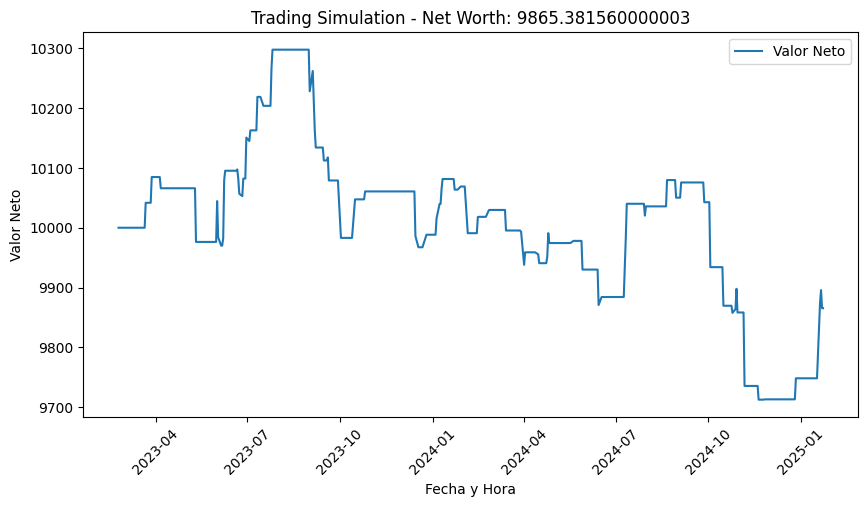

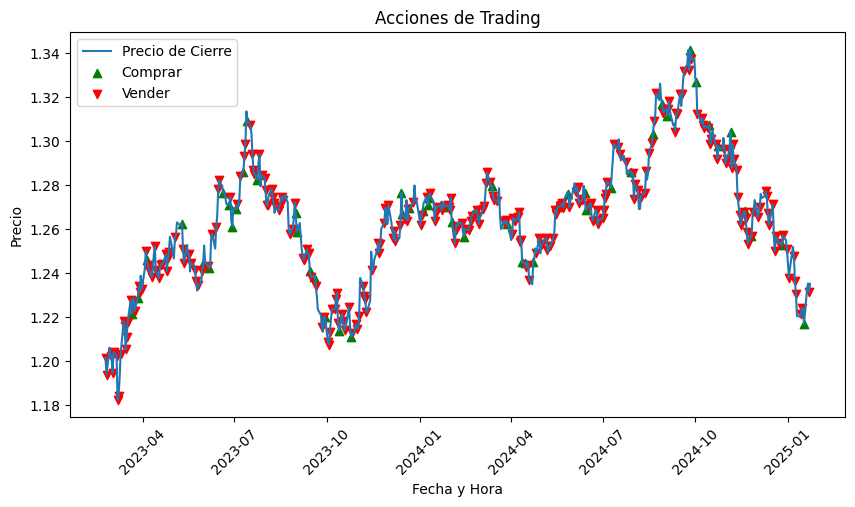

Sharpe Ratio: -0.013907856548422715
Maximum Drawdown: nan
Total Return: -134.61843999999655
Average Return: -2.5628908889484493e-05


In [63]:
nombre_modelo = 'a2c_trading_acciones_20250223_172608.zip'
# Cargar el modelo guardado
modelo_cargado = A2C.load(nombre_modelo)


# Test model
test_env = StockTradingEnv(test_data, render_mode='human')
obs, _ = test_env.reset()
net_worths = []
fechas = test_data.index
for i in range(len(test_data)):
        action, _states = modelo_cargado.predict(obs)
        obs, rewards, terminated, truncated, info = test_env.step(action)
        net_worths.append(test_env.net_worth)
        test_env.render()

# Rutina de visualización
plt.figure(figsize=(10, 5))
plt.plot(fechas, net_worths, label='Valor Neto')
plt.xlabel('Fecha y Hora')
plt.ylabel('Valor Neto')
plt.title(f'Trading Simulation - Net Worth: {test_env.net_worth}')
plt.legend()
plt.xticks(rotation=45)
plt.show()

# Graficar precios de acciones
acciones = pd.DataFrame(test_env.action_history, columns=['Paso', 'Accion', 'Precio'])
plt.figure(figsize=(10, 5))
plt.plot(fechas, test_data['Close'].reset_index(drop=True), label='Precio de Cierre')
plt.scatter(fechas[acciones[acciones['Accion'] == 1]['Paso']], acciones[acciones['Accion'] == 1]['Precio'], color='green', label='Comprar', marker='^', alpha=1)
plt.scatter(fechas[acciones[acciones['Accion'] == 2]['Paso']], acciones[acciones['Accion'] == 2]['Precio'], color='red', label='Vender', marker='v', alpha=1)
plt.xlabel('Fecha y Hora')
plt.ylabel('Precio')
plt.title('Acciones de Trading')
plt.legend()
plt.xticks(rotation=45)
plt.show()

# Calculate returns
returns = pd.Series(net_worths).pct_change()
sharpe_ratio = returns.mean() / returns.std()
print(f'Sharpe Ratio: {sharpe_ratio}')

# Calculate maximum drawdown
cumulative_returns = (1 + returns).cumprod()
running_max = np.maximum.accumulate(cumulative_returns)
drawdown = cumulative_returns / running_max - 1
max_drawdown = drawdown.min()
print(f'Maximum Drawdown: {max_drawdown}')

# Calculate total return
total_return = test_env.net_worth - test_env.initial_net_worth
print(f'Total Return: {total_return}')

# Calculate average return
average_return = returns.mean()
print(f'Average Return: {average_return}')


In [81]:
import pandas as pd
from sklearn.preprocessing import MinMaxScaler
from stable_baselines3 import A2C
from stable_baselines3.common.env_checker import check_env
from stable_baselines3.common.vec_env import DummyVecEnv
import gymnasium as gym
from datetime import datetime
import numpy as np
import matplotlib.pyplot as plt

# Definir el entorno StockTradingEnv
class EntornoTradingAcciones(gym.Env):
    def __init__(self, df, modo_render=None):
        super(EntornoTradingAcciones, self).__init__()
        self.df = df
        self.action_space = gym.spaces.Discrete(3)  # Comprar, Mantener, Vender
        self.observation_space = gym.spaces.Box(low=-np.inf, high=np.inf, shape=(df.shape[1],), dtype=np.float32)
        self.current_step = 0
        self.balance = 10000
        self.shares_held = 0
        self.net_worth = 10000
        self.render_mode = modo_render
        self.action_history = []

    def reset(self, seed=None, options=None):
        super().reset(seed=seed)
        self.current_step = 0
        self.balance = 10000
        self.shares_held = 0
        self.net_worth = 10000
        self.action_history = []
        return self._next_observation().astype(np.float32), {}

    def _next_observation(self):
        return self.df.iloc[self.current_step].values

    def step(self, action):
        self.current_step += 1
        reward = self.net_worth - 10000
        done = self.current_step >= len(self.df) - 1
        obs = self._next_observation().astype(np.float32)
        terminated = done
        truncated = False
        info = {}
        self.action_history.append([self.current_step, action, self.df.iloc[self.current_step]['Close']])
        return obs, reward, terminated, truncated, info

    def render(self, mode='human'):
        if self.render_mode is not None:
            print(f'Paso: {self.current_step}')
            print(f'Balance: {self.balance}')
            print(f'Acciones poseídas: {self.shares_held}')
            print(f'Valor neto: {self.net_worth}')



# Función para calcular el Maximum Drawdown
def calcular_max_drawdown(valores_netos):
    """
    Calcula el Maximum Drawdown (MDD) a partir de una serie de valores netos.

    :param valores_netos: Lista o array de valores netos.
    :return: El valor del Maximum Drawdown.
    """
    # Convertir a numpy array si no lo es
    valores_netos = np.array(valores_netos)
    
    # Calcular el valor máximo acumulado
    max_valor_neto = np.maximum.accumulate(valores_netos)
    
    # Calcular el drawdown
    drawdown = (valores_netos - max_valor_neto) / max_valor_neto
    
    # Calcular el Maximum Drawdown
    max_drawdown = drawdown.min()
    
    return max_drawdown



# Función para crear una nueva instancia del entorno
def make_env(df):
    return lambda: EntornoTradingAcciones(df)

# Entrenar y guardar modelos para cada combinación de dataset y rolling window
for window_diario in rolling_windows_diario:
    for window_15min in rolling_windows_15min:
        # Calcular la diferencia media
        df_diario_nuevo = calcular_diferencia_media(df_diario.copy(), window_diario)
        df_15min_nuevo = calcular_diferencia_media(df_15min.copy(), window_15min)

        # Reemplazar NaN con 0 en todo el DataFrame
        df_diario_nuevo.fillna(0, inplace=True)
        df_15min_nuevo.fillna(0, inplace=True)

        # Crear variantes de los DataFrames
        df_15min_sin_diferencia = df_15min_nuevo.drop(columns=['diferencia_media'])
        df_diario_sin_diferencia = df_diario_nuevo.drop(columns=['diferencia_media'])

        df_15min_normalizado = normalizar_df(df_15min_nuevo)
        df_diario_normalizado = normalizar_df(df_diario_nuevo)

        df_15min_sin_diferencia_normalizado = normalizar_df(df_15min_sin_diferencia)
        df_diario_sin_diferencia_normalizado = normalizar_df(df_diario_sin_diferencia)

        df_15min_filtrado = df_15min_nuevo[df_15min_nuevo['diferencia_media'] != 0]
        df_diario_filtrado = df_diario_nuevo[df_diario_nuevo['diferencia_media'] != 0]

        df_15min_filtrado_normalizado = normalizar_df(df_15min_filtrado)
        df_diario_filtrado_normalizado = normalizar_df(df_diario_filtrado)

        # Establecer la columna 'Time' como índice en todos los DataFrames
        df_15min_nuevo.set_index('Time', inplace=True)
        df_diario_nuevo.set_index('Time', inplace=True)
        df_15min_sin_diferencia.set_index('Time', inplace=True)
        df_diario_sin_diferencia.set_index('Time', inplace=True)
        df_15min_normalizado.set_index('Time', inplace=True)
        df_diario_normalizado.set_index('Time', inplace=True)
        df_15min_sin_diferencia_normalizado.set_index('Time', inplace=True)
        df_diario_sin_diferencia_normalizado.set_index('Time', inplace=True)
        df_15min_filtrado.set_index('Time', inplace=True)
        df_diario_filtrado.set_index('Time', inplace=True)
        df_15min_filtrado_normalizado.set_index('Time', inplace=True)
        df_diario_filtrado_normalizado.set_index('Time', inplace=True)

        # Crear una lista de funciones que crean entornos para cada variante del dataset
        entornos = [
            make_env(df_15min_nuevo),
            make_env(df_diario_nuevo),
            make_env(df_15min_sin_diferencia),
            make_env(df_diario_sin_diferencia),
            make_env(df_15min_normalizado),
            make_env(df_diario_normalizado),
            make_env(df_15min_sin_diferencia_normalizado),
            make_env(df_diario_sin_diferencia_normalizado),
            make_env(df_15min_filtrado),
            make_env(df_diario_filtrado),
            make_env(df_15min_filtrado_normalizado),
            make_env(df_diario_filtrado_normalizado)
        ]

        # Vectorizar los entornos
        entorno_vectorizado = DummyVecEnv(entornos)

        # Ajustar los hiperparámetros del modelo A2C
        modelo = A2C(
            'MlpPolicy',
            entorno_vectorizado,
            learning_rate=0.0007,  # Tasa de aprendizaje
            gamma=0.99,  # Factor de descuento
            n_steps=5,  # Número de pasos antes de actualizar el modelo
            ent_coef=0.01,  # Coeficiente de la pérdida de entropía
            vf_coef=0.5,  # Coeficiente de la pérdida de la función de valor
            max_grad_norm=0.5,  # Valor máximo para la normalización del gradiente
            rms_prop_eps=1e-5,  # Epsilon para RMSProp
            use_sde=False,  # Desactivar exploración de ruido de estado dependiente
            verbose=1,
            device='cpu'
        )

        # Entrenar el modelo
        modelo.learn(total_timesteps=100000)

        # Guardar el modelo con la fecha, la hora y la combinación de dataset y rolling window en el nombre del archivo
        fecha_hora_actual = datetime.now().strftime("%Y%m%d_%H%M%S")
        nombre_modelo = f"a2c_trading_acciones_{fecha_hora_actual}_diario_{window_diario}_15min_{window_15min}"
        modelo.save(nombre_modelo)

        print(f"Modelo guardado: {nombre_modelo}")

# Probar el modelo cargado con uno de los entornos, por ejemplo, el entorno de 15 minutos normalizado
modelo_cargado = A2C.load(nombre_modelo)
entorno_prueba = EntornoTradingAcciones(df_15min_normalizado, modo_render='human')
obs, _ = entorno_prueba.reset()
valores_netos = []
fechas = df_15min_normalizado.index  # Obtener las fechas del índice del DataFrame de prueba
for i in range(len(df_15min_normalizado)):
    accion, _states = modelo_cargado.predict(obs)
    obs, recompensas, terminado, truncado, info = entorno_prueba.step(accion)
    valores_netos.append(entorno_prueba.net_worth)
    entorno_prueba.render()

# Calcular el Maximum Drawdown
max_drawdown = calcular_max_drawdown(np.array(valores_netos))
print(f"Max Drawdown: {max_drawdown}")

# Rutina de visualización
plt.figure(figsize=(10, 5))
plt.plot(fechas, valores_netos, label='Valor Neto')
plt.xlabel('Fecha y Hora')
plt.ylabel('Valor Neto')
plt.title(f'Trading Simulation - Net Worth: {entorno_prueba.net_worth}')
plt.legend()
plt.xticks(rotation=45)
plt.show()

# Graficar precios de acciones
acciones = pd.DataFrame(entorno_prueba.action_history, columns=['Paso', 'Accion', 'Precio'])
plt.figure(figsize=(10, 5))
plt.plot(fechas, df_15min_normalizado['Close'].reset_index(drop=True), label='Precio de Cierre')
plt.scatter(fechas[acciones[acciones['Accion'] == 1]['Paso']], acciones[acciones['Accion'] == 1]['Precio'], color='green', label='Comprar', marker='^', alpha=1)
plt.scatter(fechas[acciones[acciones['Accion'] == 2]['Paso']], acciones[acciones['Accion'] == 2]['Precio'], color='red', label='Vender', marker='v', alpha=1)
plt.xlabel('Fecha y Hora')
plt.ylabel('Precio')
plt.title('Acciones de Trading')
plt.legend()
plt.xticks(rotation=45)
plt.show()

Using cpu device


ValueError: could not broadcast input array from shape (2,) into shape (3,)

In [84]:
import pandas as pd
from sklearn.preprocessing import MinMaxScaler
from stable_baselines3 import A2C
from stable_baselines3.common.env_checker import check_env
from stable_baselines3.common.vec_env import DummyVecEnv
import gymnasium as gym
from datetime import datetime
import numpy as np
import matplotlib.pyplot as plt

# Definir el entorno StockTradingEnv
class EntornoTradingAcciones(gym.Env):
    def __init__(self, df, modo_render=None):
        super(EntornoTradingAcciones, self).__init__()
        self.df = df
        self.action_space = gym.spaces.Discrete(3)  # Comprar, Mantener, Vender
        self.observation_space = gym.spaces.Box(low=-np.inf, high=np.inf, shape=(df.shape[1],), dtype=np.float32)
        self.current_step = 0
        self.balance = 10000
        self.shares_held = 0
        self.net_worth = 10000
        self.render_mode = modo_render
        self.action_history = []

    def reset(self, seed=None, options=None):
        super().reset(seed=seed)
        self.current_step = 0
        self.balance = 10000
        self.shares_held = 0
        self.net_worth = 10000
        self.action_history = []
        return self._next_observation().astype(np.float32), {}

    def _next_observation(self):
        return self.df.iloc[self.current_step].values

    def step(self, action):
        self.current_step += 1
        reward = self.net_worth - 10000
        done = self.current_step >= len(self.df) - 1
        obs = self._next_observation().astype(np.float32)
        terminated = done
        truncated = False
        info = {}
        self.action_history.append([self.current_step, action, self.df.iloc[self.current_step]['Close']])
        return obs, reward, terminated, truncated, info

    def render(self, mode='human'):
        if self.render_mode is not None:
            print(f'Paso: {self.current_step}')
            print(f'Balance: {self.balance}')
            print(f'Acciones poseídas: {self.shares_held}')
            print(f'Valor neto: {self.net_worth}')

# Función para calcular la diferencia media
def calcular_diferencia_media(df, window):
    df['diferencia_media'] = df['Close'].rolling(window=window).mean() - df['Close']
    return df

# Función para calcular el Maximum Drawdown
def calcular_max_drawdown(valores_netos):
    """
    Calcula el Maximum Drawdown (MDD) a partir de una serie de valores netos.

    :param valores_netos: Lista o array de valores netos.
    :return: El valor del Maximum Drawdown.
    """
    # Convertir a numpy array si no lo es
    valores_netos = np.array(valores_netos)
    
    # Calcular el valor máximo acumulado
    max_valor_neto = np.maximum.accumulate(valores_netos)
    
    # Calcular el drawdown
    drawdown = (valores_netos - max_valor_neto) / max_valor_neto
    
    # Calcular el Maximum Drawdown
    max_drawdown = drawdown.min()
    
    return max_drawdown

# Supongamos que df_15min y df_diario son tus DataFrames originales
# Asegúrate de que df_15min y df_diario estén definidos y contengan datos

# Crear variantes de los DataFrames con diferentes tamaños de rolling window
rolling_windows_diario = range(100, 1001, 100)
rolling_windows_15min = range(10000, 50001, 10000)

# Normalizar los DataFrames originales
scaler = MinMaxScaler()

# Función para normalizar DataFrames
def normalizar_df(df):
    df_normalizado = df.copy()
    columnas_a_normalizar = ['Close', 'Volume']
    df_normalizado[columnas_a_normalizar] = scaler.fit_transform(df[columnas_a_normalizar])
    return df_normalizado

# Función para crear una nueva instancia del entorno
def make_env(df):
    return lambda: EntornoTradingAcciones(df)

# Entrenar y guardar modelos para cada combinación de dataset y rolling window
for window_diario in rolling_windows_diario:
    for window_15min in rolling_windows_15min:
        # Calcular la diferencia media
        df_diario_nuevo = calcular_diferencia_media(df_diario.copy(), window_diario)
        df_15min_nuevo = calcular_diferencia_media(df_15min.copy(), window_15min)

        # Reemplazar NaN con 0 en todo el DataFrame
        df_diario_nuevo.fillna(0, inplace=True)
        df_15min_nuevo.fillna(0, inplace=True)

        # Crear variantes de los DataFrames
        df_15min_sin_diferencia = df_15min_nuevo.drop(columns=['diferencia_media'])
        df_diario_sin_diferencia = df_diario_nuevo.drop(columns=['diferencia_media'])

        df_15min_normalizado = normalizar_df(df_15min_nuevo)
        df_diario_normalizado = normalizar_df(df_diario_nuevo)

        df_15min_sin_diferencia_normalizado = normalizar_df(df_15min_sin_diferencia)
        df_diario_sin_diferencia_normalizado = normalizar_df(df_diario_sin_diferencia)

        df_15min_filtrado = df_15min_nuevo[df_15min_nuevo['diferencia_media'] != 0]
        df_diario_filtrado = df_diario_nuevo[df_diario_nuevo['diferencia_media'] != 0]

        df_15min_filtrado_normalizado = normalizar_df(df_15min_filtrado)
        df_diario_filtrado_normalizado = normalizar_df(df_diario_filtrado)

        # Establecer la columna 'Time' como índice en todos los DataFrames
        df_15min_nuevo.set_index('Time', inplace=True)
        df_diario_nuevo.set_index('Time', inplace=True)
        df_15min_sin_diferencia.set_index('Time', inplace=True)
        df_diario_sin_diferencia.set_index('Time', inplace=True)
        df_15min_normalizado.set_index('Time', inplace=True)
        df_diario_normalizado.set_index('Time', inplace=True)
        df_15min_sin_diferencia_normalizado.set_index('Time', inplace=True)
        df_diario_sin_diferencia_normalizado.set_index('Time', inplace=True)
        df_15min_filtrado.set_index('Time', inplace=True)
        df_diario_filtrado.set_index('Time', inplace=True)
        df_15min_filtrado_normalizado.set_index('Time', inplace=True)
        df_diario_filtrado_normalizado.set_index('Time', inplace=True)

        

        # Crear una lista de funciones que crean entornos para cada variante del dataset
        entornos = [
            make_env(df_15min_nuevo),
            make_env(df_diario_nuevo),
            make_env(df_15min_sin_diferencia),
            make_env(df_diario_sin_diferencia),
            make_env(df_15min_normalizado),
            make_env(df_diario_normalizado),
            make_env(df_15min_sin_diferencia_normalizado),
            make_env(df_diario_sin_diferencia_normalizado),
            make_env(df_15min_filtrado),
            make_env(df_diario_filtrado),
            make_env(df_15min_filtrado_normalizado),
            make_env(df_diario_filtrado_normalizado)
        ]

        # Vectorizar los entornos
        entorno_vectorizado = DummyVecEnv(entornos)

        # Ajustar los hiperparámetros del modelo A2C
        modelo = A2C(
            'MlpPolicy',
            entorno_vectorizado,
            learning_rate=0.0007,  # Tasa de aprendizaje
            gamma=0.99,  # Factor de descuento
            n_steps=5,  # Número de pasos antes de actualizar el modelo
            ent_coef=0.01,  # Coeficiente de la pérdida de entropía
            vf_coef=0.5,  # Coeficiente de la pérdida de la función de valor
            max_grad_norm=0.5,  # Valor máximo para la normalización del gradiente
            rms_prop_eps=1e-5,  # Epsilon para RMSProp
            use_sde=False,  # Desactivar exploración de ruido de estado dependiente
            verbose=1,
            device='cpu'
        )

        # Entrenar el modelo
        modelo.learn(total_timesteps=100000)

        # Guardar el modelo con la fecha, la hora y la combinación de dataset y rolling window en el nombre del archivo
        fecha_hora_actual = datetime.now().strftime("%Y%m%d_%H%M%S")
        nombre_modelo = f"a2c_trading_acciones_{fecha_hora_actual}_diario_{window_diario}_15min_{window_15min}"
        modelo.save(nombre_modelo)

        print(f"Modelo guardado: {nombre_modelo}")

# Probar el modelo cargado con uno de los entornos, por ejemplo, el entorno de 15 minutos normalizado
modelo_cargado = A2C.load(nombre_modelo)
entorno_prueba = EntornoTradingAcciones(df_15min_normalizado, modo_render='human')
obs, _ = entorno_prueba.reset()
valores_netos = []
fechas = df_15min_normalizado.index  # Obtener las fechas del índice del DataFrame de prueba
for i in range(len(df_15min_normalizado)):
    accion, _states = modelo_cargado.predict(obs)
    obs, recompensas, terminado, truncado, info = entorno_prueba.step(accion)
    valores_netos.append(entorno_prueba.net_worth)
    entorno_prueba.render()

# Calcular el Maximum Drawdown
max_drawdown = calcular_max_drawdown(np.array(valores_netos))
print(f"Max Drawdown: {max_drawdown}")

# Rutina de visualización
plt.figure(figsize=(10, 5))
plt.plot(fechas, valores_netos, label='Valor Neto')
plt.xlabel('Fecha y Hora')
plt.ylabel('Valor Neto')
plt.title(f'Trading Simulation - Net Worth: {entorno_prueba.net_worth}')
plt.legend()
plt.xticks(rotation=45)
plt.show()

# Graficar precios de acciones
acciones = pd.DataFrame(entorno_prueba.action_history, columns=['Paso', 'Accion', 'Precio'])
plt.figure(figsize=(10, 5))
plt.plot(fechas, df_15min_normalizado['Close'].reset_index(drop=True), label='Precio de Cierre')
plt.scatter(fechas[acciones[acciones['Accion'] == 1]['Paso']], acciones[acciones['Accion'] == 1]['Precio'], color='green', label='Comprar', marker='^', alpha=1)
plt.scatter(fechas[acciones[acciones['Accion'] == 2]['Paso']], acciones[acciones['Accion'] == 2]['Precio'], color='red', label='Vender', marker='v', alpha=1)
plt.xlabel('Fecha y Hora')
plt.ylabel('Precio')
plt.title('Acciones de Trading')
plt.legend()
plt.xticks(rotation=45)
plt.show()

Using cpu device


ValueError: could not broadcast input array from shape (2,) into shape (3,)

In [85]:
import pandas as pd
from sklearn.preprocessing import MinMaxScaler
from stable_baselines3 import A2C
from stable_baselines3.common.env_checker import check_env
from stable_baselines3.common.vec_env import DummyVecEnv
import gymnasium as gym
from datetime import datetime
import numpy as np
import matplotlib.pyplot as plt

# Definir el entorno StockTradingEnv
class EntornoTradingAcciones(gym.Env):
    def __init__(self, df, modo_render=None):
        super(EntornoTradingAcciones, self).__init__()
        self.df = df
        self.action_space = gym.spaces.Discrete(3)  # Comprar, Mantener, Vender
        self.observation_space = gym.spaces.Box(low=-np.inf, high=np.inf, shape=(df.shape[1],), dtype=np.float32)
        self.current_step = 0
        self.balance = 10000
        self.shares_held = 0
        self.net_worth = 10000
        self.render_mode = modo_render
        self.action_history = []

    def reset(self, seed=None, options=None):
        super().reset(seed=seed)
        self.current_step = 0
        self.balance = 10000
        self.shares_held = 0
        self.net_worth = 10000
        self.action_history = []
        return self._next_observation().astype(np.float32), {}

    def _next_observation(self):
        return self.df.iloc[self.current_step].values

    def step(self, action):
        self.current_step += 1
        reward = self.net_worth - 10000
        done = self.current_step >= len(self.df) - 1
        obs = self._next_observation().astype(np.float32)
        terminated = done
        truncated = False
        info = {}
        self.action_history.append([self.current_step, action, self.df.iloc[self.current_step]['Close']])
        return obs, reward, terminated, truncated, info

    def render(self, mode='human'):
        if self.render_mode is not None:
            print(f'Paso: {self.current_step}')
            print(f'Balance: {self.balance}')
            print(f'Acciones poseídas: {self.shares_held}')
            print(f'Valor neto: {self.net_worth}')

# Función para calcular la diferencia media
def calcular_diferencia_media(df, window):
    df['diferencia_media'] = df['Close'].rolling(window=window).mean() - df['Close']
    return df

# Función para calcular el Maximum Drawdown
def calcular_max_drawdown(valores_netos):
    """
    Calcula el Maximum Drawdown (MDD) a partir de una serie de valores netos.

    :param valores_netos: Lista o array de valores netos.
    :return: El valor del Maximum Drawdown.
    """
    # Convertir a numpy array si no lo es
    valores_netos = np.array(valores_netos)
    
    # Calcular el valor máximo acumulado
    max_valor_neto = np.maximum.accumulate(valores_netos)
    
    # Calcular el drawdown
    drawdown = (valores_netos - max_valor_neto) / max_valor_neto
    
    # Calcular el Maximum Drawdown
    max_drawdown = drawdown.min()
    
    return max_drawdown

# Supongamos que df_15min y df_diario son tus DataFrames originales
# Asegúrate de que df_15min y df_diario estén definidos y contengan datos

# Crear variantes de los DataFrames con diferentes tamaños de rolling window
rolling_windows_diario = range(100, 1001, 100)
rolling_windows_15min = range(10000, 50001, 10000)

# Normalizar los DataFrames originales
scaler = MinMaxScaler()

# Función para normalizar DataFrames
def normalizar_df(df):
    df_normalizado = df.copy()
    columnas_a_normalizar = ['Close', 'Volume']
    df_normalizado[columnas_a_normalizar] = scaler.fit_transform(df[columnas_a_normalizar])
    return df_normalizado

# Función para crear una nueva instancia del entorno
def make_env(df):
    return lambda: EntornoTradingAcciones(df)

# Asegurarse de que todos los DataFrames tengan las mismas columnas
def alinear_columnas(df, columnas_referencia):
    columnas_faltantes = set(columnas_referencia) - set(df.columns)
    for columna in columnas_faltantes:
        df[columna] = 0
    return df[columnas_referencia]

# Obtener las columnas de referencia del DataFrame original
columnas_referencia = df_15min.columns

# Entrenar y guardar modelos para cada combinación de dataset y rolling window
for window_diario in rolling_windows_diario:
    for window_15min in rolling_windows_15min:
        # Calcular la diferencia media
        df_diario_nuevo = calcular_diferencia_media(df_diario.copy(), window_diario)
        df_15min_nuevo = calcular_diferencia_media(df_15min.copy(), window_15min)

        # Reemplazar NaN con 0 en todo el DataFrame
        df_diario_nuevo.fillna(0, inplace=True)
        df_15min_nuevo.fillna(0, inplace=True)

        # Crear variantes de los DataFrames
        df_15min_sin_diferencia = df_15min_nuevo.drop(columns=['diferencia_media'])
        df_diario_sin_diferencia = df_diario_nuevo.drop(columns=['diferencia_media'])

        df_15min_normalizado = normalizar_df(df_15min_nuevo)
        df_diario_normalizado = normalizar_df(df_diario_nuevo)

        df_15min_sin_diferencia_normalizado = normalizar_df(df_15min_sin_diferencia)
        df_diario_sin_diferencia_normalizado = normalizar_df(df_diario_sin_diferencia)

        df_15min_filtrado = df_15min_nuevo[df_15min_nuevo['diferencia_media'] != 0]
        df_diario_filtrado = df_diario_nuevo[df_diario_nuevo['diferencia_media'] != 0]

        df_15min_filtrado_normalizado = normalizar_df(df_15min_filtrado)
        df_diario_filtrado_normalizado = normalizar_df(df_diario_filtrado)

        # Establecer la columna 'Time' como índice en todos los DataFrames
        df_15min_nuevo.set_index('Time', inplace=True)
        df_diario_nuevo.set_index('Time', inplace=True)
        df_15min_sin_diferencia.set_index('Time', inplace=True)
        df_diario_sin_diferencia.set_index('Time', inplace=True)
        df_15min_normalizado.set_index('Time', inplace=True)
        df_diario_normalizado.set_index('Time', inplace=True)
        df_15min_sin_diferencia_normalizado.set_index('Time', inplace=True)
        df_diario_sin_diferencia_normalizado.set_index('Time', inplace=True)
        df_15min_filtrado.set_index('Time', inplace=True)
        df_diario_filtrado.set_index('Time', inplace=True)
        df_15min_filtrado_normalizado.set_index('Time', inplace=True)
        df_diario_filtrado_normalizado.set_index('Time', inplace=True)

        # Alinear las columnas de todos los DataFrames con las columnas de referencia
        df_15min_nuevo = alinear_columnas(df_15min_nuevo, columnas_referencia)
        df_diario_nuevo = alinear_columnas(df_diario_nuevo, columnas_referencia)
        df_15min_sin_diferencia = alinear_columnas(df_15min_sin_diferencia, columnas_referencia)
        df_diario_sin_diferencia = alinear_columnas(df_diario_sin_diferencia, columnas_referencia)
        df_15min_normalizado = alinear_columnas(df_15min_normalizado, columnas_referencia)
        df_diario_normalizado = alinear_columnas(df_diario_normalizado, columnas_referencia)
        df_15min_sin_diferencia_normalizado = alinear_columnas(df_15min_sin_diferencia_normalizado, columnas_referencia)
        df_diario_sin_diferencia_normalizado = alinear_columnas(df_diario_sin_diferencia_normalizado, columnas_referencia)
        df_15min_filtrado = alinear_columnas(df_15min_filtrado, columnas_referencia)
        df_diario_filtrado = alinear_columnas(df_diario_filtrado, columnas_referencia)
        df_15min_filtrado_normalizado = alinear_columnas(df_15min_filtrado_normalizado, columnas_referencia)
        df_diario_filtrado_normalizado = alinear_columnas(df_diario_filtrado_normalizado, columnas_referencia)

        # Crear una lista de funciones que crean entornos para cada variante del dataset
        entornos = [
            make_env(df_15min_nuevo),
            make_env(df_diario_nuevo),
            make_env(df_15min_sin_diferencia),
            make_env(df_diario_sin_diferencia),
            make_env(df_15min_normalizado),
            make_env(df_diario_normalizado),
            make_env(df_15min_sin_diferencia_normalizado),
            make_env(df_diario_sin_diferencia_normalizado),
            make_env(df_15min_filtrado),
            make_env(df_diario_filtrado),
            make_env(df_15min_filtrado_normalizado),
            make_env(df_diario_filtrado_normalizado)
        ]

        # Vectorizar los entornos
        entorno_vectorizado = DummyVecEnv(entornos)

        # Ajustar los hiperparámetros del modelo A2C
        modelo = A2C(
            'MlpPolicy',
            entorno_vectorizado,
            learning_rate=0.0007,  # Tasa de aprendizaje
            gamma=0.99,  # Factor de descuento
            n_steps=5,  # Número de pasos antes de actualizar el modelo
            ent_coef=0.01,  # Coeficiente de la pérdida de entropía
            vf_coef=0.5,  # Coeficiente de la pérdida de la función de valor
            max_grad_norm=0.5,  # Valor máximo para la normalización del gradiente
            rms_prop_eps=1e-5,  # Epsilon para RMSProp
            use_sde=False,  # Desactivar exploración de ruido de estado dependiente
            verbose=1,
            device='cpu'
        )

        # Entrenar el modelo
        modelo.learn(total_timesteps=100000)

        # Guardar el modelo con la fecha, la hora y la combinación de dataset y rolling window en el nombre del archivo
        fecha_hora_actual = datetime.now().strftime("%Y%m%d_%H%M%S")
        nombre_modelo = f"a2c_trading_acciones_{fecha_hora_actual}_diario_{window_diario}_15min_{window_15min}"
        modelo.save(nombre_modelo)

        print(f"Modelo guardado: {nombre_modelo}")

# Probar el modelo cargado con uno de los entornos, por ejemplo, el entorno de 15 minutos normalizado
modelo_cargado = A2C.load(nombre_modelo)
entorno_prueba = EntornoTradingAcciones(df_15min_normalizado, modo_render='human')
obs, _ = entorno_prueba.reset()
valores_netos = []
fechas = df_15min_normalizado.index  # Obtener las fechas del índice del DataFrame de prueba
for i in range(len(df_15min_normalizado)):
    accion, _states = modelo_cargado.predict(obs)
    obs, recompensas, terminado, truncado, info = entorno_prueba.step(accion)
    valores_netos.append(entorno_prueba.net_worth)
    entorno_prueba.render()

# Calcular el Maximum Drawdown
max_drawdown = calcular_max_drawdown(np.array(valores_netos))
print(f"Max Drawdown: {max_drawdown}")

# Rutina de visualización
plt.figure(figsize=(10, 5))
plt.plot(fechas, valores_netos, label='Valor Neto')
plt.xlabel('Fecha y Hora')
plt.ylabel('Valor Neto')
plt.title(f'Trading Simulation - Net Worth: {entorno_prueba.net_worth}')
plt.legend()
plt.xticks(rotation=45)
plt.show()

# Graficar precios de acciones
acciones = pd.DataFrame(entorno_prueba.action_history, columns=['Paso', 'Accion', 'Precio'])
plt.figure(figsize=(10, 5))
plt.plot(fechas, df_15min_normalizado['Close'].reset_index(drop=True), label='Precio de Cierre')
plt.scatter(fechas[acciones[acciones['Accion'] == 1]['Paso']], acciones[acciones['Accion'] == 1]['Precio'], color='green', label='Comprar', marker='^', alpha=1)
plt.scatter(fechas[acciones[acciones['Accion'] == 2]['Paso']], acciones[acciones['Accion'] == 2]['Precio'], color='red', label='Vender', marker='v', alpha=1)
plt.xlabel('Fecha y Hora')
plt.ylabel('Precio')
plt.title('Acciones de Trading')
plt.legend()
plt.xticks(rotation=45)
plt.show()

Using cpu device
------------------------------------
| time/                 |          |
|    fps                | 701      |
|    iterations         | 100      |
|    time_elapsed       | 8        |
|    total_timesteps    | 6000     |
| train/                |          |
|    entropy_loss       | -1.1     |
|    explained_variance | 0.862    |
|    learning_rate      | 0.0007   |
|    n_updates          | 99       |
|    policy_loss        | 0.00154  |
|    value_loss         | 1.23e-05 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 701      |
|    iterations         | 200      |
|    time_elapsed       | 17       |
|    total_timesteps    | 12000    |
| train/                |          |
|    entropy_loss       | -1.1     |
|    explained_variance | 0.985    |
|    learning_rate      | 0.0007   |
|    n_updates          | 199      |
|    policy_loss        | 0.000406 |
|    value_loss      

KeyboardInterrupt: 

In [86]:
import pandas as pd
from sklearn.preprocessing import MinMaxScaler
from stable_baselines3 import A2C
from stable_baselines3.common.env_checker import check_env
from stable_baselines3.common.vec_env import DummyVecEnv
import gymnasium as gym
from datetime import datetime
import numpy as np
import matplotlib.pyplot as plt

# Definir el entorno StockTradingEnv
class EntornoTradingAcciones(gym.Env):
    def __init__(self, df, modo_render=None):
        super(EntornoTradingAcciones, self).__init__()
        self.df = df
        self.action_space = gym.spaces.Discrete(3)  # Comprar, Mantener, Vender
        self.observation_space = gym.spaces.Box(low=-np.inf, high=np.inf, shape=(df.shape[1],), dtype=np.float32)
        self.current_step = 0
        self.balance = 10000
        self.shares_held = 0
        self.net_worth = 10000
        self.render_mode = modo_render
        self.action_history = []

    def reset(self, seed=None, options=None):
        super().reset(seed=seed)
        self.current_step = 0
        self.balance = 10000
        self.shares_held = 0
        self.net_worth = 10000
        self.action_history = []
        return self._next_observation().astype(np.float32), {}

    def _next_observation(self):
        return self.df.iloc[self.current_step].values

    def step(self, action):
        self.current_step += 1
        reward = self.net_worth - 10000
        done = self.current_step >= len(self.df) - 1
        obs = self._next_observation().astype(np.float32)
        terminated = done
        truncated = False
        info = {}
        self.action_history.append([self.current_step, action, self.df.iloc[self.current_step]['Close']])
        return obs, reward, terminated, truncated, info

    def render(self, mode='human'):
        if self.render_mode is not None:
            print(f'Paso: {self.current_step}')
            print(f'Balance: {self.balance}')
            print(f'Acciones poseídas: {self.shares_held}')
            print(f'Valor neto: {self.net_worth}')

# Función para calcular la diferencia media
def calcular_diferencia_media(df, window):
    df['diferencia_media'] = df['Close'].rolling(window=window).mean() - df['Close']
    return df

# Función para calcular el Maximum Drawdown
def calcular_max_drawdown(valores_netos):
    """
    Calcula el Maximum Drawdown (MDD) a partir de una serie de valores netos.

    :param valores_netos: Lista o array de valores netos.
    :return: El valor del Maximum Drawdown.
    """
    # Convertir a numpy array si no lo es
    valores_netos = np.array(valores_netos)
    
    # Calcular el valor máximo acumulado
    max_valor_neto = np.maximum.accumulate(valores_netos)
    
    # Calcular el drawdown
    drawdown = (valores_netos - max_valor_neto) / max_valor_neto
    
    # Calcular el Maximum Drawdown
    max_drawdown = drawdown.min()
    
    return max_drawdown

# Supongamos que df_15min y df_diario son tus DataFrames originales
# Asegúrate de que df_15min y df_diario estén definidos y contengan datos

# Crear variantes de los DataFrames con diferentes tamaños de rolling window
rolling_windows_diario = range(100, 1001, 100)
rolling_windows_15min = range(10000, 50001, 10000)

# Normalizar los DataFrames originales
scaler = MinMaxScaler()

# Función para normalizar DataFrames
def normalizar_df(df):
    df_normalizado = df.copy()
    columnas_a_normalizar = ['Close', 'Volume']
    df_normalizado[columnas_a_normalizar] = scaler.fit_transform(df[columnas_a_normalizar])
    return df_normalizado

# Función para crear una nueva instancia del entorno
def make_env(df):
    return lambda: EntornoTradingAcciones(df)

# Asegurarse de que todos los DataFrames tengan las mismas columnas
def alinear_columnas(df, columnas_referencia):
    columnas_faltantes = set(columnas_referencia) - set(df.columns)
    for columna in columnas_faltantes:
        df[columna] = 0
    return df[columnas_referencia]

# Obtener las columnas de referencia del DataFrame original
columnas_referencia = df_15min.columns

# Entrenar y guardar modelos para los datasets de 15 minutos
for window_15min in rolling_windows_15min:
    # Calcular la diferencia media
    df_15min_nuevo = calcular_diferencia_media(df_15min.copy(), window_15min)

    # Reemplazar NaN con 0 en todo el DataFrame
    df_15min_nuevo.fillna(0, inplace=True)

    # Crear variantes de los DataFrames
    df_15min_sin_diferencia = df_15min_nuevo.drop(columns=['diferencia_media'])
    df_15min_normalizado = normalizar_df(df_15min_nuevo)
    df_15min_sin_diferencia_normalizado = normalizar_df(df_15min_sin_diferencia)
    df_15min_filtrado = df_15min_nuevo[df_15min_nuevo['diferencia_media'] != 0]
    df_15min_filtrado_normalizado = normalizar_df(df_15min_filtrado)

    # Establecer la columna 'Time' como índice en todos los DataFrames
    df_15min_nuevo.set_index('Time', inplace=True)
    df_15min_sin_diferencia.set_index('Time', inplace=True)
    df_15min_normalizado.set_index('Time', inplace=True)
    df_15min_sin_diferencia_normalizado.set_index('Time', inplace=True)
    df_15min_filtrado.set_index('Time', inplace=True)
    df_15min_filtrado_normalizado.set_index('Time', inplace=True)

    # Alinear las columnas de todos los DataFrames con las columnas de referencia
    df_15min_nuevo = alinear_columnas(df_15min_nuevo, columnas_referencia)
    df_15min_sin_diferencia = alinear_columnas(df_15min_sin_diferencia, columnas_referencia)
    df_15min_normalizado = alinear_columnas(df_15min_normalizado, columnas_referencia)
    df_15min_sin_diferencia_normalizado = alinear_columnas(df_15min_sin_diferencia_normalizado, columnas_referencia)
    df_15min_filtrado = alinear_columnas(df_15min_filtrado, columnas_referencia)
    df_15min_filtrado_normalizado = alinear_columnas(df_15min_filtrado_normalizado, columnas_referencia)

    # Crear una lista de funciones que crean entornos para cada variante del dataset
    entornos = [
        make_env(df_15min_nuevo),
        make_env(df_15min_sin_diferencia),
        make_env(df_15min_normalizado),
        make_env(df_15min_sin_diferencia_normalizado),
        make_env(df_15min_filtrado),
        make_env(df_15min_filtrado_normalizado)
    ]

    # Vectorizar los entornos
    entorno_vectorizado = DummyVecEnv(entornos)

    # Ajustar los hiperparámetros del modelo A2C
    modelo = A2C(
        'MlpPolicy',
        entorno_vectorizado,
        learning_rate=0.0007,  # Tasa de aprendizaje
        gamma=0.99,  # Factor de descuento
        n_steps=5,  # Número de pasos antes de actualizar el modelo
        ent_coef=0.01,  # Coeficiente de la pérdida de entropía
        vf_coef=0.5,  # Coeficiente de la pérdida de la función de valor
        max_grad_norm=0.5,  # Valor máximo para la normalización del gradiente
        rms_prop_eps=1e-5,  # Epsilon para RMSProp
        use_sde=False,  # Desactivar exploración de ruido de estado dependiente
        verbose=1,
        device='cpu'
    )

    # Entrenar el modelo
    modelo.learn(total_timesteps=100000)

    # Guardar el modelo con la fecha, la hora y la combinación de dataset y rolling window en el nombre del archivo
    fecha_hora_actual = datetime.now().strftime("%Y%m%d_%H%M%S")
    nombre_modelo = f"a2c_trading_acciones_15min_{window_15min}_{fecha_hora_actual}"
    modelo.save(nombre_modelo)

    print(f"Modelo guardado: {nombre_modelo}")

# Entrenar y guardar modelos para los datasets diarios
for window_diario in rolling_windows_diario:
    # Calcular la diferencia media
    df_diario_nuevo = calcular_diferencia_media(df_diario.copy(), window_diario)

    # Reemplazar NaN con 0 en todo el DataFrame
    df_diario_nuevo.fillna(0, inplace=True)

    # Crear variantes de los DataFrames
    df_diario_sin_diferencia = df_diario_nuevo.drop(columns=['diferencia_media'])
    df_diario_normalizado = normalizar_df(df_diario_nuevo)
    df_diario_sin_diferencia_normalizado = normalizar_df(df_diario_sin_diferencia)
    df_diario_filtrado = df_diario_nuevo[df_diario_nuevo['diferencia_media'] != 0]
    df_diario_filtrado_normalizado = normalizar_df(df_diario_filtrado)

    # Establecer la columna 'Time' como índice en todos los DataFrames
    df_diario_nuevo.set_index('Time', inplace=True)
    df_diario_sin_diferencia.set_index('Time', inplace=True)
    df_diario_normalizado.set_index('Time', inplace=True)
    df_diario_sin_diferencia_normalizado.set_index('Time', inplace=True)
    df_diario_filtrado.set_index('Time', inplace=True)
    df_diario_filtrado_normalizado.set_index('Time', inplace=True)

    # Alinear las columnas de todos los DataFrames con las columnas de referencia
    df_diario_nuevo = alinear_columnas(df_diario_nuevo, columnas_referencia)
    df_diario_sin_diferencia = alinear_columnas(df_diario_sin_diferencia, columnas_referencia)
    df_diario_normalizado = alinear_columnas(df_diario_normalizado, columnas_referencia)
    df_diario_sin_diferencia_normalizado = alinear_columnas(df_diario_sin_diferencia_normalizado, columnas_referencia)
    df_diario_filtrado = alinear_columnas(df_diario_filtrado, columnas_referencia)
    df_diario_filtrado_normalizado = alinear_columnas(df_diario_filtrado_normalizado, columnas_referencia)

    # Crear una lista de funciones que crean entornos para cada variante del dataset
    entornos = [
        make_env(df_diario_nuevo),
        make_env(df_diario_sin_diferencia),
        make_env(df_diario_normalizado),
        make_env(df_diario_sin_diferencia_normalizado),
        make_env(df_diario_filtrado),
        make_env(df_diario_filtrado_normalizado)
    ]

    # Vectorizar los entornos
    entorno_vectorizado = DummyVecEnv(entornos)

    # Ajustar los hiperparámetros del modelo A2C
    modelo = A2C(
        'MlpPolicy',
        entorno_vectorizado,
        learning_rate=0.0007,  # Tasa de aprendizaje
        gamma=0.99,  # Factor de descuento
        n_steps=5,  # Número de pasos antes de actualizar el modelo
        ent_coef=0.01,  # Coeficiente de la pérdida de entropía
        vf_coef=0.5,  # Coeficiente de la pérdida de la función de valor
        max_grad_norm=0.5,  # Valor máximo para la normalización del gradiente
        rms_prop_eps=1e-5,  # Epsilon para RMSProp
        use_sde=False,  # Desactivar exploración de ruido de estado dependiente
        verbose=1,
        device='cpu'
    )

    # Entrenar el modelo
    modelo.learn(total_timesteps=100000)

    # Guardar el modelo con la fecha, la hora y la combinación de dataset y rolling window en el nombre del archivo
    fecha_hora_actual = datetime.now().strftime("%Y%m%d_%H%M%S")
    nombre_modelo = f"a2c_trading_acciones_diario_{window_diario}_{fecha_hora_actual}"
    modelo.save(nombre_modelo)

    print(f"Modelo guardado: {nombre_modelo}")

Using cpu device
-------------------------------------
| time/                 |           |
|    fps                | 572       |
|    iterations         | 100       |
|    time_elapsed       | 5         |
|    total_timesteps    | 3000      |
| train/                |           |
|    entropy_loss       | -1.1      |
|    explained_variance | 0.991     |
|    learning_rate      | 0.0007    |
|    n_updates          | 99        |
|    policy_loss        | -2.94e-05 |
|    value_loss         | 5.01e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 581       |
|    iterations         | 200       |
|    time_elapsed       | 10        |
|    total_timesteps    | 6000      |
| train/                |           |
|    entropy_loss       | -1.1      |
|    explained_variance | 0.994     |
|    learning_rate      | 0.0007    |
|    n_updates          | 199       |
|    policy_loss        | -4.72e-

: 

In [4]:
import pandas as pd
from sklearn.preprocessing import MinMaxScaler
from stable_baselines3 import A2C
from stable_baselines3.common.env_checker import check_env
from stable_baselines3.common.vec_env import DummyVecEnv
import gymnasium as gym
from datetime import datetime
import numpy as np
import matplotlib.pyplot as plt
import os
from itertools import product

# Definir el entorno StockTradingEnv
class EntornoTradingAcciones(gym.Env):
    def __init__(self, df, modo_render=None):
        super(EntornoTradingAcciones, self).__init__()
        self.df = df
        self.action_space = gym.spaces.Discrete(3)  # Comprar, Mantener, Vender
        self.observation_space = gym.spaces.Box(low=-np.inf, high=np.inf, shape=(df.shape[1],), dtype=np.float32)
        self.current_step = 0
        self.balance = 10000
        self.shares_held = 0
        self.net_worth = 10000
        self.render_mode = modo_render
        self.action_history = []

    def reset(self, seed=None, options=None):
        super().reset(seed=seed)
        self.current_step = 0
        self.balance = 10000
        self.shares_held = 0
        self.net_worth = 10000
        self.action_history = []
        return self._next_observation().astype(np.float32), {}

    def _next_observation(self):
        return self.df.iloc[self.current_step].values

    def step(self, action):
        self.current_step += 1
        reward = self.net_worth - 10000
        done = self.current_step >= len(self.df) - 1
        obs = self._next_observation().astype(np.float32)
        terminated = done
        truncated = False
        info = {}
        self.action_history.append([self.current_step, action, self.df.iloc[self.current_step]['Close']])
        return obs, reward, terminated, truncated, info

    def render(self, mode='human'):
        if self.render_mode is not None:
            print(f'Paso: {self.current_step}')
            print(f'Balance: {self.balance}')
            print(f'Acciones poseídas: {self.shares_held}')
            print(f'Valor neto: {self.net_worth}')

# Función para calcular la diferencia media
def calcular_diferencia_media(df, window):
    df['diferencia_media'] = df['Close'].rolling(window=window).mean() - df['Close']
    return df

# Función para calcular el Maximum Drawdown
def calcular_max_drawdown(valores_netos):
    """
    Calcula el Maximum Drawdown (MDD) a partir de una serie de valores netos.

    :param valores_netos: Lista o array de valores netos.
    :return: El valor del Maximum Drawdown.
    """
    # Convertir a numpy array si no lo es
    valores_netos = np.array(valores_netos)
    
    # Calcular el valor máximo acumulado
    max_valor_neto = np.maximum.accumulate(valores_netos)
    
    # Calcular el drawdown
    drawdown = (valores_netos - max_valor_neto) / max_valor_neto
    
    # Calcular el Maximum Drawdown
    max_drawdown = drawdown.min()
    
    return max_drawdown

# Supongamos que df_15min y df_diario son tus DataFrames originales
# Asegúrate de que df_15min y df_diario estén definidos y contengan datos

# Crear variantes de los DataFrames con diferentes tamaños de rolling window
rolling_windows_diario = range(100, 1001, 100)
rolling_windows_15min = range(10000, 50001, 10000)

# Normalizar los DataFrames originales
scaler = MinMaxScaler()

# Función para normalizar DataFrames
def normalizar_df(df):
    df_normalizado = df.copy()
    columnas_a_normalizar = ['Close', 'Volume']
    df_normalizado[columnas_a_normalizar] = scaler.fit_transform(df[columnas_a_normalizar])
    return df_normalizado

# Función para crear una nueva instancia del entorno
def make_env(df):
    return lambda: EntornoTradingAcciones(df)

# Asegurarse de que todos los DataFrames tengan las mismas columnas
def alinear_columnas(df, columnas_referencia):
    columnas_faltantes = set(columnas_referencia) - set(df.columns)
    for columna in columnas_faltantes:
        df[columna] = 0
    return df[columnas_referencia]

# Obtener las columnas de referencia del DataFrame original
columnas_referencia = df_15min.columns

# Crear el directorio para guardar los modelos
os.makedirs('modelos', exist_ok=True)

# Listas de valores para los parámetros del modelo
learning_rates = [0.0003, 0.0007, 0.001]
gammas = [0.95, 0.99]
n_steps_list = [5, 10]
ent_coefs = [0.01, 0.05]
vf_coefs = [0.5, 0.7]
max_grad_norms = [0.5, 1.0]
rms_prop_eps_list = [1e-5, 1e-6]

# Entrenar y guardar modelos para los datasets de 15 minutos
for window_15min in rolling_windows_15min:
    # Calcular la diferencia media
    df_15min_nuevo = calcular_diferencia_media(df_15min.copy(), window_15min)

    # Reemplazar NaN con 0 en todo el DataFrame
    df_15min_nuevo.fillna(0, inplace=True)

    # Crear variantes de los DataFrames
    df_15min_sin_diferencia = df_15min_nuevo.drop(columns=['diferencia_media'])
    df_15min_normalizado = normalizar_df(df_15min_nuevo)
    df_15min_sin_diferencia_normalizado = normalizar_df(df_15min_sin_diferencia)
    df_15min_filtrado = df_15min_nuevo[df_15min_nuevo['diferencia_media'] != 0]
    df_15min_filtrado_normalizado = normalizar_df(df_15min_filtrado)

    # Establecer la columna 'Time' como índice en todos los DataFrames
    df_15min_nuevo.set_index('Time', inplace=True)
    df_15min_sin_diferencia.set_index('Time', inplace=True)
    df_15min_normalizado.set_index('Time', inplace=True)
    df_15min_sin_diferencia_normalizado.set_index('Time', inplace=True)
    df_15min_filtrado.set_index('Time', inplace=True)
    df_15min_filtrado_normalizado.set_index('Time', inplace=True)

    # Alinear las columnas de todos los DataFrames con las columnas de referencia
    df_15min_nuevo = alinear_columnas(df_15min_nuevo, columnas_referencia)
    df_15min_sin_diferencia = alinear_columnas(df_15min_sin_diferencia, columnas_referencia)
    df_15min_normalizado = alinear_columnas(df_15min_normalizado, columnas_referencia)
    df_15min_sin_diferencia_normalizado = alinear_columnas(df_15min_sin_diferencia_normalizado, columnas_referencia)
    df_15min_filtrado = alinear_columnas(df_15min_filtrado, columnas_referencia)
    df_15min_filtrado_normalizado = alinear_columnas(df_15min_filtrado_normalizado, columnas_referencia)

    # Crear una lista de funciones que crean entornos para cada variante del dataset
    entornos = [
        make_env(df_15min_nuevo),
        make_env(df_15min_sin_diferencia),
        make_env(df_15min_normalizado),
        make_env(df_15min_sin_diferencia_normalizado),
        make_env(df_15min_filtrado),
        make_env(df_15min_filtrado_normalizado)
    ]

    # Vectorizar los entornos
    entorno_vectorizado = DummyVecEnv(entornos)

    # Iterar sobre todas las combinaciones de parámetros
    for lr, gamma, n_steps, ent_coef, vf_coef, max_grad_norm, rms_prop_eps in product(
        learning_rates, gammas, n_steps_list, ent_coefs, vf_coefs, max_grad_norms, rms_prop_eps_list
    ):
        # Ajustar los hiperparámetros del modelo A2C
        modelo = A2C(
            'MlpPolicy',
            entorno_vectorizado,
            learning_rate=lr,
            gamma=gamma,
            n_steps=n_steps,
            ent_coef=ent_coef,
            vf_coef=vf_coef,
            max_grad_norm=max_grad_norm,
            rms_prop_eps=rms_prop_eps,
            use_sde=False,
            verbose=1,
            device='cpu'
        )

        # Entrenar el modelo
        modelo.learn(total_timesteps=100000)

        # Guardar el modelo con la fecha, la hora y la combinación de dataset y rolling window en el nombre del archivo
        fecha_hora_actual = datetime.now().strftime("%Y%m%d_%H%M%S")
        nombre_modelo = f"modelos/a2c_trading_acciones_15min_{window_15min}_{fecha_hora_actual}_lr{lr}_gamma{gamma}_nsteps{n_steps}_entcoef{ent_coef}_vfcoef{vf_coef}_maxgradnorm{max_grad_norm}_rmspropeps{rms_prop_eps}"
        modelo.save(nombre_modelo)

        print(f"Modelo guardado: {nombre_modelo}")

# Entrenar y guardar modelos para los datasets diarios
for window_diario in rolling_windows_diario:
    # Calcular la diferencia media
    df_diario_nuevo = calcular_diferencia_media(df_diario.copy(), window_diario)

    # Reemplazar NaN con 0 en todo el DataFrame
    df_diario_nuevo.fillna(0, inplace=True)

    # Crear variantes de los DataFrames
    df_diario_sin_diferencia = df_diario_nuevo.drop(columns=['diferencia_media'])
    df_diario_normalizado = normalizar_df(df_diario_nuevo)
    df_diario_sin_diferencia_normalizado = normalizar_df(df_diario_sin_diferencia)
    df_diario_filtrado = df_diario_nuevo[df_diario_nuevo['diferencia_media'] != 0]
    df_diario_filtrado_normalizado = normalizar_df(df_diario_filtrado)

    # Establecer la columna 'Time' como índice en todos los DataFrames
    df_diario_nuevo.set_index('Time', inplace=True)
    df_diario_sin_diferencia.set_index('Time', inplace=True)
    df_diario_normalizado.set_index('Time', inplace=True)
    df_diario_sin_diferencia_normalizado.set_index('Time', inplace=True)
    df_diario_filtrado.set_index('Time', inplace=True)
    df_diario_filtrado_normalizado.set_index('Time', inplace=True)

    # Alinear las columnas de todos los DataFrames con las columnas de referencia
    df_diario_nuevo = alinear_columnas(df_diario_nuevo, columnas_referencia)
    df_diario_sin_diferencia = alinear_columnas(df_diario_sin_diferencia, columnas_referencia)
    df_diario_normalizado = alinear_columnas(df_diario_normalizado, columnas_referencia)
    df_diario_sin_diferencia_normalizado = alinear_columnas(df_diario_sin_diferencia_normalizado, columnas_referencia)
    df_diario_filtrado = alinear_columnas(df_diario_filtrado, columnas_referencia)
    df_diario_filtrado_normalizado = alinear_columnas(df_diario_filtrado_normalizado, columnas_referencia)

    # Crear una lista de funciones que crean entornos para cada variante del dataset
    entornos = [
        make_env(df_diario_nuevo),
        make_env(df_diario_sin_diferencia),
        make_env(df_diario_normalizado),
        make_env(df_diario_sin_diferencia_normalizado),
        make_env(df_diario_filtrado),
        make_env(df_diario_filtrado_normalizado)
    ]

    # Vectorizar los entornos
    entorno_vectorizado = DummyVecEnv(entornos)

    # Iterar sobre todas las combinaciones de parámetros
    for lr, gamma, n_steps, ent_coef, vf_coef, max_grad_norm, rms_prop_eps in product(
        learning_rates, gammas, n_steps_list, ent_coefs, vf_coefs, max_grad_norms, rms_prop_eps_list
    ):
        # Ajustar los hiperparámetros del modelo A2C
        modelo = A2C(
            'MlpPolicy',
            entorno_vectorizado,
            learning_rate=lr,
            gamma=gamma,
            n_steps=n_steps,
            ent_coef=ent_coef,
            vf_coef=vf_coef,
            max_grad_norm=max_grad_norm,
            rms_prop_eps=rms_prop_eps,
            use_sde=False,
            verbose=1,
            device='cpu'
        )

        # Entrenar el modelo
        modelo.learn(total_timesteps=100000)

        # Guardar el modelo con la fecha, la hora y la combinación de dataset y rolling window en el nombre del archivo
        fecha_hora_actual = datetime.now().strftime("%Y%m%d_%H%M%S")
        nombre_modelo = f"modelos/a2c_trading_acciones_diario_{window_diario}_{fecha_hora_actual}_lr{lr}_gamma{gamma}_nsteps{n_steps}_entcoef{ent_coef}_vfcoef{vf_coef}_maxgradnorm{max_grad_norm}_rmspropeps{rms_prop_eps}"
        modelo.save(nombre_modelo)

        print(f"Modelo guardado: {nombre_modelo}")

Using cpu device
-------------------------------------
| time/                 |           |
|    fps                | 940       |
|    iterations         | 100       |
|    time_elapsed       | 3         |
|    total_timesteps    | 3000      |
| train/                |           |
|    entropy_loss       | -1.1      |
|    explained_variance | 0.897     |
|    learning_rate      | 0.0003    |
|    n_updates          | 99        |
|    policy_loss        | -0.000423 |
|    value_loss         | 4.29e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 1229     |
|    iterations         | 200      |
|    time_elapsed       | 4        |
|    total_timesteps    | 6000     |
| train/                |          |
|    entropy_loss       | -1.1     |
|    explained_variance | 0.978    |
|    learning_rate      | 0.0003   |
|    n_updates          | 199      |
|    policy_loss        | -0.00165 |
|    va

KeyboardInterrupt: 

In [ ]:
import pandas as pd
from sklearn.preprocessing import MinMaxScaler
from stable_baselines3 import A2C
from stable_baselines3.common.env_checker import check_env
from stable_baselines3.common.vec_env import DummyVecEnv
import gymnasium as gym
from datetime import datetime
import numpy as np
import matplotlib.pyplot as plt
import os

# Definir el entorno StockTradingEnv
class EntornoTradingAcciones(gym.Env):
    def __init__(self, df, modo_render=None):
        super(EntornoTradingAcciones, self).__init__()
        self.df = df
        self.action_space = gym.spaces.Discrete(3)  # Comprar, Mantener, Vender
        self.observation_space = gym.spaces.Box(low=-np.inf, high=np.inf, shape=(df.shape[1],), dtype=np.float32)
        self.current_step = 0
        self.balance = 10000
        self.shares_held = 0
        self.net_worth = 10000
        self.render_mode = modo_render
        self.action_history = []

    def reset(self, seed=None, options=None):
        super().reset(seed=seed)
        self.current_step = 0
        self.balance = 10000
        self.shares_held = 0
        self.net_worth = 10000
        self.action_history = []
        return self._next_observation().astype(np.float32), {}

    def _next_observation(self):
        return self.df.iloc[self.current_step].values

    def step(self, action):
        self.current_step += 1
        reward = self.net_worth - 10000
        done = self.current_step >= len(self.df) - 1
        obs = self._next_observation().astype(np.float32)
        terminated = done
        truncated = False
        info = {}
        self.action_history.append([self.current_step, action, self.df.iloc[self.current_step]['Close']])
        return obs, reward, terminated, truncated, info

    def render(self, mode='human'):
        if self.render_mode is not None:
            print(f'Paso: {self.current_step}')
            print(f'Balance: {self.balance}')
            print(f'Acciones poseídas: {self.shares_held}')
            print(f'Valor neto: {self.net_worth}')

# Función para calcular la diferencia media
def calcular_diferencia_media(df, window):
    df['diferencia_media'] = df['Close'].rolling(window=window).mean() - df['Close']
    return df

# Función para calcular el Maximum Drawdown
def calcular_max_drawdown(valores_netos):
    """
    Calcula el Maximum Drawdown (MDD) a partir de una serie de valores netos.

    :param valores_netos: Lista o array de valores netos.
    :return: El valor del Maximum Drawdown.
    """
    # Convertir a numpy array si no lo es
    valores_netos = np.array(valores_netos)
    
    # Calcular el valor máximo acumulado
    max_valor_neto = np.maximum.accumulate(valores_netos)
    
    # Calcular el drawdown
    drawdown = (valores_netos - max_valor_neto) / max_valor_neto
    
    # Calcular el Maximum Drawdown
    max_drawdown = drawdown.min()
    
    return max_drawdown

# Supongamos que test_data es tu DataFrame de prueba
# Asegúrate de que test_data esté definido y contenga datos

# Crear el directorio para guardar los resultados de las simulaciones
os.makedirs('resultados', exist_ok=True)

# Obtener la lista de modelos en la carpeta 'modelos'
modelos = [f for f in os.listdir('modelos') if f.endswith('.zip')]

# Ejecutar simulaciones con cada modelo
for nombre_modelo in modelos:
    # Cargar el modelo guardado
    modelo_cargado = A2C.load(os.path.join('modelos', nombre_modelo))

    # Crear el entorno de prueba
    test_env = EntornoTradingAcciones(test_data, modo_render='human')
    obs, _ = test_env.reset()
    net_worths = []
    fechas = test_data.index
    for i in range(len(test_data)):
        action, _states = modelo_cargado.predict(obs)
        obs, rewards, terminated, truncated, info = test_env.step(action)
        net_worths.append(test_env.net_worth)
        test_env.render()

    # Rutina de visualización
    plt.figure(figsize=(10, 5))
    plt.plot(fechas, net_worths, label='Valor Neto')
    plt.xlabel('Fecha y Hora')
    plt.ylabel('Valor Neto')
    plt.title(f'Trading Simulation - Net Worth: {test_env.net_worth}')
    plt.legend()
    plt.xticks(rotation=45)
    plt.savefig(f'resultados/{nombre_modelo}_net_worth.png')
    plt.close()

    # Graficar precios de acciones
    acciones = pd.DataFrame(test_env.action_history, columns=['Paso', 'Accion', 'Precio'])
    plt.figure(figsize=(10, 5))
    plt.plot(fechas, test_data['Close'].reset_index(drop=True), label='Precio de Cierre')
    plt.scatter(fechas[acciones[acciones['Accion'] == 1]['Paso']], acciones[acciones['Accion'] == 1]['Precio'], color='green', label='Comprar', marker='^', alpha=1)
    plt.scatter(fechas[acciones[acciones['Accion'] == 2]['Paso']], acciones[acciones['Accion'] == 2]['Precio'], color='red', label='Vender', marker='v', alpha=1)
    plt.xlabel('Fecha y Hora')
    plt.ylabel('Precio')
    plt.title('Acciones de Trading')
    plt.legend()
    plt.xticks(rotation=45)
    plt.savefig(f'resultados/{nombre_modelo}_acciones.png')
    plt.close()

    # Calcular y guardar el Sharpe Ratio
    returns = pd.Series(net_worths).pct_change()
    sharpe_ratio = returns.mean() / returns.std()
    with open(f'resultados/{nombre_modelo}_sharpe_ratio.txt', 'w') as f:
        f.write(f'Sharpe Ratio: {sharpe_ratio}\n')

    print(f'Modelo {nombre_modelo} evaluado y resultados guardados.')

In [7]:
# Supongamos que test_data es tu DataFrame de prueba
# Asegúrate de que test_data esté definido y contenga datos
# Lista para almacenar los resultados
resultados = []
# Crear el directorio para guardar los resultados de las simulaciones
os.makedirs('resultados', exist_ok=True)

# Obtener la lista de modelos en la carpeta 'modelos'
modelos = [f for f in os.listdir('modelos') if f.endswith('.zip')]

# Ejecutar simulaciones con cada modelo y guardar los resultados
for nombre_modelo in modelos:
    # Cargar el modelo guardado
    modelo_cargado = A2C.load(os.path.join('modelos', nombre_modelo))

    # Crear el entorno de prueba
    test_env = EntornoTradingAcciones(test_data, modo_render='human')
    obs, _ = test_env.reset()
    net_worths = []
    fechas = test_data.index
    for i in range(len(test_data)):
        action, _states = modelo_cargado.predict(obs)
        obs, rewards, terminated, truncated, info = test_env.step(action)
        net_worths.append(test_env.net_worth)

    # Calcular el Sharpe Ratio
    returns = pd.Series(net_worths).pct_change()
    sharpe_ratio = returns.mean() / returns.std()

    # Guardar los resultados en la lista
    resultados.append({
        'modelo': nombre_modelo,
        'sharpe_ratio': sharpe_ratio,
        'net_worth': test_env.net_worth
    })

# Crear un DataFrame con los resultados y guardarlo en un archivo CSV
df_resultados = pd.DataFrame(resultados)
df_resultados.to_csv('resultados/resultados_modelos.csv', index=False)

# Graficar los resultados
df_resultados_15min = df_resultados[df_resultados['modelo'].str.contains('15min')]
df_resultados_diario = df_resultados[df_resultados['modelo'].str.contains('diario')]

# Graficar resultados para modelos de 15 minutos
plt.figure(figsize=(15, 7))
plt.plot(df_resultados_15min['modelo'], df_resultados_15min['net_worth'], label='Net Worth')
plt.xticks(rotation=90)
plt.xlabel('Modelos')
plt.ylabel('Net Worth')
plt.title('Performance de Modelos - 15 Minutos')
plt.legend()
top_10_15min = df_resultados_15min.nlargest(10, 'net_worth')
for i in top_10_15min.index:
    plt.annotate('Top 10', (i, top_10_15min.loc[i, 'net_worth']), textcoords="offset points", xytext=(0,10), ha='center')
plt.savefig('resultados/performance_15min.png')
plt.close()

# Graficar resultados para modelos diarios
plt.figure(figsize=(15, 7))
plt.plot(df_resultados_diario['modelo'], df_resultados_diario['net_worth'], label='Net Worth')
plt.xticks(rotation=90)
plt.xlabel('Modelos')
plt.ylabel('Net Worth')
plt.title('Performance de Modelos - Diario')
plt.legend()
top_10_diario = df_resultados_diario.nlargest(10, 'net_worth')
for i in top_10_diario.index:
    plt.annotate('Top 10', (i, top_10_diario.loc[i, 'net_worth']), textcoords="offset points", xytext=(0,10), ha='center')
plt.savefig('resultados/performance_diario.png')
plt.close()

KeyError: 'modelo'

In [ ]:
import pandas as pd
from sklearn.preprocessing import MinMaxScaler
from stable_baselines3 import A2C
from stable_baselines3.common.vec_env import DummyVecEnv
import gymnasium as gym
import numpy as np
import matplotlib.pyplot as plt
import os
import re

# Definir el entorno StockTradingEnv
class EntornoTradingAcciones(gym.Env):
    def __init__(self, df, modo_render=None):
        super(EntornoTradingAcciones, self).__init__()
        self.df = df
        self.action_space = gym.spaces.Discrete(3)  # Comprar, Mantener, Vender
        self.observation_space = gym.spaces.Box(low=-np.inf, high=np.inf, shape=(df.shape[1],), dtype=np.float32)
        self.current_step = 0
        self.balance = 10000
        self.shares_held = 0
        self.net_worth = 10000
        self.render_mode = modo_render
        self.action_history = []

    def reset(self, seed=None, options=None):
        super().reset(seed=seed)
        self.current_step = 0
        self.balance = 10000
        self.shares_held = 0
        self.net_worth = 10000
        self.action_history = []
        return self._next_observation().astype(np.float32), {}

    def _next_observation(self):
        return self.df.iloc[self.current_step].values

    def step(self, action):
        self.current_step += 1
        reward = self.net_worth - 10000
        done = self.current_step >= len(self.df) - 1
        obs = self._next_observation().astype(np.float32)
        terminated = done
        truncated = False
        info = {}
        self.action_history.append([self.current_step, action, self.df.iloc[self.current_step]['Close']])
        return obs, reward, terminated, truncated, info

    def render(self, mode='human'):
        if self.render_mode is not None:
            print(f'Paso: {self.current_step}')
            print(f'Balance: {self.balance}')
            print(f'Acciones poseídas: {self.shares_held}')
            print(f'Valor neto: {self.net_worth}')

# Función para calcular la diferencia media
def calcular_diferencia_media(df, window):
    df['diferencia_media'] = df['Close'].rolling(window=window).mean() - df['Close']
    return df

# Función para normalizar DataFrames
def normalizar_df(df):
    scaler = MinMaxScaler()
    df_normalizado = df.copy()
    columnas_a_normalizar = ['Close', 'Volume']
    df_normalizado[columnas_a_normalizar] = scaler.fit_transform(df[columnas_a_normalizar])
    return df_normalizado

# Función para crear una nueva instancia del entorno
def make_env(df):
    return lambda: EntornoTradingAcciones(df)

# Asegurarse de que todos los DataFrames tengan las mismas columnas
def alinear_columnas(df, columnas_referencia):
    columnas_faltantes = set(columnas_referencia) - set(df.columns)
    for columna in columnas_faltantes:
        df[columna] = 0
    return df[columnas_referencia]

# # Supongamos que df_15min y df_diario son tus DataFrames originales
# # Asegúrate de que df_15min y df_diario estén definidos y contengan datos
# df_15min = pd.read_csv('path_to_15min_data.csv')
# df_diario = pd.read_csv('path_to_daily_data.csv')


# Cargar archivos CSV en DataFrames de pandas, especificando la primera columna como el índice
df_diario = pd.read_csv('fx_data\\GBPUSD_D1', sep=';', index_col=0)
df_15min = pd.read_csv('fx_data\\GBPUSD_15min', sep=';', index_col=0)

# Eliminar columnas con 'Unnamed' en su nombre
df_diario = df_diario.loc[:, ~df_diario.columns.str.contains('^Unnamed')]
df_15min = df_15min.loc[:, ~df_15min.columns.str.contains('^Unnamed')]

# Eliminar las columnas especificadas
columnas_a_eliminar = [ 'Open', 'High', 'Low', 'Real_volume', 'Spread', 'timeframe', 'symbol']
df_diario = df_diario.drop(columns=columnas_a_eliminar)
df_15min = df_15min.drop(columns=columnas_a_eliminar)


# Convertir la columna 'Time' a datetime
df_diario['Time'] = pd.to_datetime(df_diario['Time'])
df_15min['Time'] = pd.to_datetime(df_15min['Time'])

# Obtener las columnas de referencia del DataFrame original
columnas_referencia = df_15min.columns

# Crear el directorio para guardar los resultados
os.makedirs('resultados', exist_ok=True)

# Lista para almacenar los resultados
resultados = []

# Obtener la lista de modelos en la carpeta 'modelos'
modelos = [f for f in os.listdir('modelos') if f.endswith('.zip')]

# Evaluar cada modelo
for nombre_modelo in modelos:
    # Extraer información del nombre del modelo
    match = re.search(r'_(15min|diario)_(\d+)_', nombre_modelo)
    if match:
        tipo = match.group(1)
        window = int(match.group(2))

        # Seleccionar el dataset correspondiente
        if tipo == '15min':
            df = df_15min.copy()
        else:
            df = df_diario.copy()

        # Calcular la diferencia media
        df = calcular_diferencia_media(df, window)

        # Reemplazar NaN con 0 en todo el DataFrame
        df.fillna(0, inplace=True)

        # Normalizar el DataFrame
        df_normalizado = normalizar_df(df)

        # Alinear las columnas del DataFrame con las columnas de referencia
        df_normalizado = alinear_columnas(df_normalizado, columnas_referencia)

        # Cargar el modelo guardado
        modelo_cargado = A2C.load(os.path.join('modelos', nombre_modelo))

        # Crear el entorno de prueba
        test_env = EntornoTradingAcciones(df_normalizado, modo_render=None)
        obs, _ = test_env.reset()
        net_worths = []
        for i in range(len(df_normalizado)):
            action, _states = modelo_cargado.predict(obs)
            obs, rewards, terminated, truncated, info = test_env.step(action)
            net_worths.append(test_env.net_worth)
            if terminated or truncated:
                break

        # Calcular el rendimiento
        rendimiento = net_worths[-1] - net_worths[0]
        resultados.append([nombre_modelo, rendimiento])

# Guardar los resultados en un archivo CSV
resultados_df = pd.DataFrame(resultados, columns=['Modelo', 'Rendimiento'])
resultados_df.to_csv('resultados/resultados_modelos.csv', index=False)

# Renderizar la gráfica de resultados para los modelos de 15 minutos
resultados_15min = resultados_df[resultados_df['Modelo'].str.contains('15min')]
resultados_15min = resultados_15min.sort_values(by='Rendimiento', ascending=False)
top_10_15min = resultados_15min.head(10)

plt.figure(figsize=(12, 6))
plt.plot(resultados_15min['Modelo'], resultados_15min['Rendimiento'], label='Rendimiento')
plt.scatter(top_10_15min['Modelo'], top_10_15min['Rendimiento'], color='red', label='Top 10', zorder=5)
plt.xlabel('Modelo')
plt.ylabel('Rendimiento')
plt.title('Rendimiento de Modelos - 15 Minutos')
plt.legend()
plt.xticks(rotation=90)
plt.tight_layout()
plt.savefig('resultados/rendimiento_modelos_15min.png')
plt.close()

# Renderizar la gráfica de resultados para los modelos diarios
resultados_diario = resultados_df[resultados_df['Modelo'].str.contains('diario')]
resultados_diario = resultados_diario.sort_values(by='Rendimiento', ascending=False)
top_10_diario = resultados_diario.head(10)

plt.figure(figsize=(12, 6))
plt.plot(resultados_diario['Modelo'], resultados_diario['Rendimiento'], label='Rendimiento')
plt.scatter(top_10_diario['Modelo'], top_10_diario['Rendimiento'], color='red', label='Top 10', zorder=5)
plt.xlabel('Modelo')
plt.ylabel('Rendimiento')
plt.title('Rendimiento de Modelos - Diario')
plt.legend()
plt.xticks(rotation=90)
plt.tight_layout()
plt.savefig('resultados/rendimiento_modelos_diario.png')
plt.close()

In [15]:
import pandas as pd
from sklearn.preprocessing import MinMaxScaler
from stable_baselines3 import A2C
from stable_baselines3.common.vec_env import DummyVecEnv
import gymnasium as gym
import numpy as np
import matplotlib.pyplot as plt
import os
import re

# Definir el entorno StockTradingEnv
class EntornoTradingAcciones(gym.Env):
    def __init__(self, df, modo_render=None):
        super(EntornoTradingAcciones, self).__init__()
        self.df = df
        self.action_space = gym.spaces.Discrete(3)  # Comprar, Mantener, Vender
        self.observation_space = gym.spaces.Box(low=-np.inf, high=np.inf, shape=(df.shape[1],), dtype=np.float32)
        self.current_step = 0
        self.balance = 10000
        self.shares_held = 0
        self.net_worth = 10000
        self.render_mode = modo_render
        self.action_history = []

    def reset(self, seed=None, options=None):
        super().reset(seed=seed)
        self.current_step = 0
        self.balance = 10000
        self.shares_held = 0
        self.net_worth = 10000
        self.action_history = []
        return self._next_observation().astype(np.float32), {}

    def _next_observation(self):
        return self.df.iloc[self.current_step].values

    def step(self, action):
        self.current_step += 1
        reward = self.net_worth - 10000
        done = self.current_step >= len(self.df) - 1
        obs = self._next_observation().astype(np.float32)
        terminated = done
        truncated = False
        info = {}
        self.action_history.append([self.current_step, action, self.df.iloc[self.current_step]['Close']])
        return obs, reward, terminated, truncated, info

    def render(self, mode='human'):
        if self.render_mode is not None:
            print(f'Paso: {self.current_step}')
            print(f'Balance: {self.balance}')
            print(f'Acciones poseídas: {self.shares_held}')
            print(f'Valor neto: {self.net_worth}')

# Función para calcular la diferencia media
def calcular_diferencia_media(df, window):
    df['diferencia_media'] = df['Close'].rolling(window=window).mean() - df['Close']
    return df

# Función para normalizar DataFrames
def normalizar_df(df):
    scaler = MinMaxScaler()
    df_normalizado = df.copy()
    columnas_a_normalizar = ['Close', 'Volume']
    df_normalizado[columnas_a_normalizar] = scaler.fit_transform(df[columnas_a_normalizar])
    return df_normalizado

# Función para crear una nueva instancia del entorno
def make_env(df):
    return lambda: EntornoTradingAcciones(df)

# Asegurarse de que todos los DataFrames tengan las mismas columnas
def alinear_columnas(df, columnas_referencia):
    columnas_faltantes = set(columnas_referencia) - set(df.columns)
    for columna in columnas_faltantes:
        df[columna] = 0
    return df[columnas_referencia]

# # Supongamos que df_15min y df_diario son tus DataFrames originales
# # Asegúrate de que df_15min y df_diario estén definidos y contengan datos
# df_15min = pd.read_csv('path_to_15min_data.csv')
# df_diario = pd.read_csv('path_to_daily_data.csv')

# Cargar archivos CSV en DataFrames de pandas, especificando la primera columna como el índice
df_diario = pd.read_csv('fx_data\\GBPUSD_D1', sep=';', index_col=0)
df_15min = pd.read_csv('fx_data\\GBPUSD_15min', sep=';', index_col=0)

# Eliminar columnas con 'Unnamed' en su nombre
df_diario = df_diario.loc[:, ~df_diario.columns.str.contains('^Unnamed')]
df_15min = df_15min.loc[:, ~df_15min.columns.str.contains('^Unnamed')]

# Eliminar las columnas especificadas
columnas_a_eliminar = [ 'Open', 'High', 'Low', 'Real_volume', 'Spread', 'timeframe', 'symbol']
df_diario = df_diario.drop(columns=columnas_a_eliminar)
df_15min = df_15min.drop(columns=columnas_a_eliminar)


# Convertir la columna 'Time' a datetime
df_diario['Time'] = pd.to_datetime(df_diario['Time'])
df_15min['Time'] = pd.to_datetime(df_15min['Time'])


# Obtener las columnas de referencia del DataFrame original
columnas_referencia = df_15min.columns

# Crear el directorio para guardar los resultados
os.makedirs('resultados', exist_ok=True)

# Lista para almacenar los resultados
resultados = []

# Obtener la lista de modelos en la carpeta 'modelos'
modelos = [f for f in os.listdir('C:\\Users\\cyber\\Documents\\Deep Learning\\Deep Reinforcement Learning\\modelos')]
            #if f.endswith('.zip')]
#print (modelos)
# Evaluar cada modelo
for nombre_modelo in modelos:
    # Extraer información del nombre del modelo
    match = re.search(r'_(15min|diario)_(\d+)_', nombre_modelo)
    if match:
        tipo = match.group(1)
        window = int(match.group(2))

        # Seleccionar el dataset correspondiente
        if tipo == '15min':
            df = df_15min.copy()
        else:
            df = df_diario.copy()

        # Calcular la diferencia media
        df = calcular_diferencia_media(df, window)

        # Reemplazar NaN con 0 en todo el DataFrame
        df.fillna(0, inplace=True)

        # Crear variantes normalizadas y no normalizadas
        df_normalizado = normalizar_df(df)
        df_no_normalizado = df.copy()

        # Alinear las columnas de los DataFrames con las columnas de referencia
        df_normalizado = alinear_columnas(df_normalizado, columnas_referencia)
        df_no_normalizado = alinear_columnas(df_no_normalizado, columnas_referencia)

        # Evaluar el modelo con ambos datasets
        for df_variant, variant_name in [(df_normalizado, 'normalizado'), (df_no_normalizado, 'no_normalizado')]:
            # Cargar el modelo guardado
            modelo_cargado = A2C.load(os.path.join('modelos', nombre_modelo))

            # Crear el entorno de prueba
            test_env = EntornoTradingAcciones(df_variant, modo_render=None)
            obs, _ = test_env.reset()
            net_worths = []
            for i in range(len(df_variant)):
                action, _states = modelo_cargado.predict(obs)
                obs, rewards, terminated, truncated, info = test_env.step(action)
                net_worths.append(test_env.net_worth)
                if terminated or truncated:
                    break

            # Calcular el rendimiento
            rendimiento = net_worths[-1] - net_worths[0]
            resultados.append([nombre_modelo, tipo, variant_name, rendimiento])

# Guardar los resultados en un archivo CSV
resultados_df = pd.DataFrame(resultados, columns=['Modelo', 'Tipo', 'Variante', 'Rendimiento'])
resultados_df.to_csv('resultados/resultados_modelos.csv', index=False)

# Función para renderizar gráficos
def renderizar_grafico(resultados_df, tipo, variante, filename):
    resultados_filtrados = resultados_df[(resultados_df['Tipo'] == tipo) & (resultados_df['Variante'] == variante)]
    resultados_filtrados = resultados_filtrados.sort_values(by='Rendimiento', ascending=False)
    top_10 = resultados_filtrados.head(10)

    plt.figure(figsize=(12, 6))
    plt.plot(resultados_filtrados['Modelo'], resultados_filtrados['Rendimiento'], label='Rendimiento')
    plt.scatter(top_10['Modelo'], top_10['Rendimiento'], color='red', label='Top 10', zorder=5)
    plt.xlabel('Modelo')
    plt.ylabel('Rendimiento')
    plt.title(f'Rendimiento de Modelos - {tipo.capitalize()} - {variante.capitalize()}')
    plt.legend()
    plt.xticks(rotation=90)
    plt.tight_layout()
    plt.savefig(filename)
    plt.close()

# Renderizar gráficos para cada grupo
renderizar_grafico(resultados_df, '15min', 'normalizado', 'resultados/rendimiento_modelos_15min_normalizado.png')
renderizar_grafico(resultados_df, '15min', 'no_normalizado', 'resultados/rendimiento_modelos_15min_no_normalizado.png')
renderizar_grafico(resultados_df, 'diario', 'normalizado', 'resultados/rendimiento_modelos_diario_normalizado.png')
renderizar_grafico(resultados_df, 'diario', 'no_normalizado', 'resultados/rendimiento_modelos_diario_no_normalizado.png')

c:\Users\cyber\AppData\Local\Programs\Python\Python312\Lib\site-packages\stable_baselines3\common\on_policy_algorithm.py:150: UserWarning: You are trying to run A2C on the GPU, but it is primarily intended to run on the CPU when not using a CNN policy (you are using ActorCriticPolicy which should be a MlpPolicy). See https://github.com/DLR-RM/stable-baselines3/issues/1245 for more info. You can pass `device='cpu'` or `export CUDA_VISIBLE_DEVICES=` to force using the CPU.Note: The model will train, but the GPU utilization will be poor and the training might take longer than on CPU.
  warnings.warn(


TypeError: float() argument must be a string or a real number, not 'Timestamp'

In [17]:
import pandas as pd
from sklearn.preprocessing import MinMaxScaler
from stable_baselines3 import A2C
from stable_baselines3.common.vec_env import DummyVecEnv
import gymnasium as gym
import numpy as np
import matplotlib.pyplot as plt
import os
import re

# Definir el entorno StockTradingEnv
class EntornoTradingAcciones(gym.Env):
    def __init__(self, df, modo_render=None):
        super(EntornoTradingAcciones, self).__init__()
        self.df = df
        self.action_space = gym.spaces.Discrete(3)  # Comprar, Mantener, Vender
        self.observation_space = gym.spaces.Box(low=-np.inf, high=np.inf, shape=(df.shape[1],), dtype=np.float32)
        self.current_step = 0
        self.balance = 10000
        self.shares_held = 0
        self.net_worth = 10000
        self.render_mode = modo_render
        self.action_history = []

    def reset(self, seed=None, options=None):
        super().reset(seed=seed)
        self.current_step = 0
        self.balance = 10000
        self.shares_held = 0
        self.net_worth = 10000
        self.action_history = []
        return self._next_observation().astype(np.float32), {}

    def _next_observation(self):
        return self.df.iloc[self.current_step].values

    def step(self, action):
        self.current_step += 1
        reward = self.net_worth - 10000
        done = self.current_step >= len(self.df) - 1
        obs = self._next_observation().astype(np.float32)
        terminated = done
        truncated = False
        info = {}
        self.action_history.append([self.current_step, action, self.df.iloc[self.current_step]['Close']])
        return obs, reward, terminated, truncated, info

    def render(self, mode='human'):
        if self.render_mode is not None:
            print(f'Paso: {self.current_step}')
            print(f'Balance: {self.balance}')
            print(f'Acciones poseídas: {self.shares_held}')
            print(f'Valor neto: {self.net_worth}')

# Función para calcular la diferencia media
def calcular_diferencia_media(df, window):
    df['diferencia_media'] = df['Close'].rolling(window=window).mean() - df['Close']
    return df

# Función para normalizar DataFrames
def normalizar_df(df):
    scaler = MinMaxScaler()
    df_normalizado = df.copy()
    columnas_a_normalizar = ['Close', 'Volume']
    df_normalizado[columnas_a_normalizar] = scaler.fit_transform(df[columnas_a_normalizar])
    return df_normalizado

# Función para crear una nueva instancia del entorno
def make_env(df):
    return lambda: EntornoTradingAcciones(df)

# Asegurarse de que todos los DataFrames tengan las mismas columnas
def alinear_columnas(df, columnas_referencia):
    columnas_faltantes = set(columnas_referencia) - set(df.columns)
    for columna in columnas_faltantes:
        df[columna] = 0
    return df[columnas_referencia]

# Cargar archivos CSV en DataFrames de pandas, especificando la primera columna como el índice
df_diario = pd.read_csv('fx_data\\GBPUSD_D1', sep=';', index_col=0)
df_15min = pd.read_csv('fx_data\\GBPUSD_15min', sep=';', index_col=0)

# Eliminar columnas con 'Unnamed' en su nombre
df_diario = df_diario.loc[:, ~df_diario.columns.str.contains('^Unnamed')]
df_15min = df_15min.loc[:, ~df_15min.columns.str.contains('^Unnamed')]

# Eliminar las columnas especificadas
columnas_a_eliminar = ['Open', 'High', 'Low', 'Real_volume', 'Spread', 'timeframe', 'symbol']
df_diario = df_diario.drop(columns=columnas_a_eliminar)
df_15min = df_15min.drop(columns=columnas_a_eliminar)

# Convertir la columna 'Time' a datetime
df_diario['Time'] = pd.to_datetime(df_diario['Time'])
df_15min['Time'] = pd.to_datetime(df_15min['Time'])

# Obtener las columnas de referencia del DataFrame original
columnas_referencia = df_15min.columns

# Crear el directorio para guardar los resultados
os.makedirs('resultados', exist_ok=True)

# Lista para almacenar los resultados
resultados = []

# Obtener la lista de modelos en la carpeta 'modelos'
modelos = [f for f in os.listdir('modelos') ]

# Evaluar cada modelo
for nombre_modelo in modelos:
    # Extraer información del nombre del modelo
    match = re.search(r'_(15min|diario)_(\d+)_', nombre_modelo)
    if match:
        tipo = match.group(1)
        window = int(match.group(2))

        # Seleccionar el dataset correspondiente
        if tipo == '15min':
            df = df_15min.copy()
        else:
            df = df_diario.copy()

        # Calcular la diferencia media
        df = calcular_diferencia_media(df, window)

        # Reemplazar NaN con 0 en todo el DataFrame
        df.fillna(0, inplace=True)

        # Crear variantes normalizadas y no normalizadas
        df_normalizado = normalizar_df(df)
        df_no_normalizado = df.copy()

        # Alinear las columnas de los DataFrames con las columnas de referencia
        df_normalizado = alinear_columnas(df_normalizado, columnas_referencia)
        df_no_normalizado = alinear_columnas(df_no_normalizado, columnas_referencia)

        # Eliminar la columna 'Time' antes de pasar el DataFrame al entorno de prueba
        df_normalizado = df_normalizado.drop(columns=['Time'])
        df_no_normalizado = df_no_normalizado.drop(columns=['Time'])

        # Evaluar el modelo con ambos datasets
        for df_variant, variant_name in [(df_normalizado, 'normalizado'), (df_no_normalizado, 'no_normalizado')]:
            # Cargar el modelo guardado
            modelo_cargado = A2C.load(os.path.join('modelos', nombre_modelo))

            # Crear el entorno de prueba
            test_env = EntornoTradingAcciones(df_variant, modo_render=None)
            obs, _ = test_env.reset()
            net_worths = []
            for i in range(len(df_variant)):
                action, _states = modelo_cargado.predict(obs)
                obs, rewards, terminated, truncated, info = test_env.step(action)
                net_worths.append(test_env.net_worth)
                if terminated or truncated:
                    break

            # Calcular el rendimiento
            rendimiento = net_worths[-1] - net_worths[0]
            resultados.append([nombre_modelo, tipo, variant_name, rendimiento])

# Guardar los resultados en un archivo CSV
resultados_df = pd.DataFrame(resultados, columns=['Modelo', 'Tipo', 'Variante', 'Rendimiento'])
resultados_df.to_csv('resultados/resultados_modelos.csv', index=False)

# Función para renderizar gráficos
def renderizar_grafico(resultados_df, tipo, variante, filename):
    resultados_filtrados = resultados_df[(resultados_df['Tipo'] == tipo) & (resultados_df['Variante'] == variante)]
    resultados_filtrados = resultados_filtrados.sort_values(by='Rendimiento', ascending=False)
    top_10 = resultados_filtrados.head(10)

    plt.figure(figsize=(12, 6))
    plt.plot(resultados_filtrados['Modelo'], resultados_filtrados['Rendimiento'], label='Rendimiento')
    plt.scatter(top_10['Modelo'], top_10['Rendimiento'], color='red', label='Top 10', zorder=5)
    plt.xlabel('Modelo')
    plt.ylabel('Rendimiento')
    plt.title(f'Rendimiento de Modelos - {tipo.capitalize()} - {variante.capitalize()}')
    plt.legend()
    plt.xticks(rotation=90)
    plt.tight_layout()
    plt.savefig(filename)
    plt.close()

# Renderizar gráficos para cada grupo
renderizar_grafico(resultados_df, '15min', 'normalizado', 'resultados/rendimiento_modelos_15min_normalizado.png')
renderizar_grafico(resultados_df, '15min', 'no_normalizado', 'resultados/rendimiento_modelos_15min_no_normalizado.png')
renderizar_grafico(resultados_df, 'diario', 'normalizado', 'resultados/rendimiento_modelos_diario_normalizado.png')
renderizar_grafico(resultados_df, 'diario', 'no_normalizado', 'resultados/rendimiento_modelos_diario_no_normalizado.png')

c:\Users\cyber\AppData\Local\Programs\Python\Python312\Lib\site-packages\stable_baselines3\common\on_policy_algorithm.py:150: UserWarning: You are trying to run A2C on the GPU, but it is primarily intended to run on the CPU when not using a CNN policy (you are using ActorCriticPolicy which should be a MlpPolicy). See https://github.com/DLR-RM/stable-baselines3/issues/1245 for more info. You can pass `device='cpu'` or `export CUDA_VISIBLE_DEVICES=` to force using the CPU.Note: The model will train, but the GPU utilization will be poor and the training might take longer than on CPU.
  warnings.warn(


ValueError: Error: Unexpected observation shape (2,) for Box environment, please use (3,) or (n_env, 3) for the observation shape.

In [18]:
import pandas as pd
from sklearn.preprocessing import MinMaxScaler
from stable_baselines3 import A2C
from stable_baselines3.common.vec_env import DummyVecEnv
import gymnasium as gym
import numpy as np
import matplotlib.pyplot as plt
import os
import re

# Definir el entorno StockTradingEnv
class EntornoTradingAcciones(gym.Env):
    def __init__(self, df, modo_render=None):
        super(EntornoTradingAcciones, self).__init__()
        self.df = df
        self.action_space = gym.spaces.Discrete(3)  # Comprar, Mantener, Vender
        self.observation_space = gym.spaces.Box(low=-np.inf, high=np.inf, shape=(df.shape[1],), dtype=np.float32)
        self.current_step = 0
        self.balance = 10000
        self.shares_held = 0
        self.net_worth = 10000
        self.render_mode = modo_render
        self.action_history = []

    def reset(self, seed=None, options=None):
        super().reset(seed=seed)
        self.current_step = 0
        self.balance = 10000
        self.shares_held = 0
        self.net_worth = 10000
        self.action_history = []
        return self._next_observation().astype(np.float32), {}

    def _next_observation(self):
        return self.df.iloc[self.current_step].values

    def step(self, action):
        self.current_step += 1
        reward = self.net_wworth - 10000
        done = self.current_step >= len(self.df) - 1
        obs = self._next_observation().astype(np.float32)
        terminated = done
        truncated = False
        info = {}
        self.action_history.append([self.current_step, action, self.df.iloc[self.current_step]['Close']])
        return obs, reward, terminated, truncated, info

    def render(self, mode='human'):
        if self.render_mode is not None:
            print(f'Paso: {self.current_step}')
            print(f'Balance: {self.balance}')
            print(f'Acciones poseídas: {self.shares_held}')
            print(f'Valor neto: {self.net_worth}')

# Función para calcular la diferencia media
def calcular_diferencia_media(df, window):
    df['diferencia_media'] = df['Close'].rolling(window=window).mean() - df['Close']
    return df

# Función para normalizar DataFrames
def normalizar_df(df):
    scaler = MinMaxScaler()
    df_normalizado = df.copy()
    columnas_a_normalizar = ['Close', 'Volume']
    df_normalizado[columnas_a_normalizar] = scaler.fit_transform(df[columnas_a_normalizar])
    return df_normalizado

# Función para crear una nueva instancia del entorno
def make_env(df):
    return lambda: EntornoTradingAcciones(df)

# Asegurarse de que todos los DataFrames tengan las mismas columnas
def alinear_columnas(df, columnas_referencia):
    columnas_faltantes = set(columnas_referencia) - set(df.columns)
    for columna in columnas_faltantes:
        df[columna] = 0
    return df[columnas_referencia]

# Cargar archivos CSV en DataFrames de pandas, especificando la primera columna como el índice
df_diario = pd.read_csv('fx_data\\GBPUSD_D1', sep=';', index_col=0)
df_15min = pd.read_csv('fx_data\\GBPUSD_15min', sep=';', index_col=0)

# Eliminar columnas con 'Unnamed' en su nombre
df_diario = df_diario.loc[:, ~df_diario.columns.str.contains('^Unnamed')]
df_15min = df_15min.loc[:, ~df_15min.columns.str.contains('^Unnamed')]

# Eliminar las columnas especificadas
columnas_a_eliminar = ['Open', 'High', 'Low', 'Real_volume', 'Spread', 'timeframe', 'symbol']
df_diario = df_diario.drop(columns=columnas_a_eliminar)
df_15min = df_15min.drop(columns=columnas_a_eliminar)

# Convertir la columna 'Time' a datetime
df_diario['Time'] = pd.to_datetime(df_diario['Time'])
df_15min['Time'] = pd.to_datetime(df_15min['Time'])

# Obtener las columnas de referencia del DataFrame original
columnas_referencia = df_15min.columns

# Crear el directorio para guardar los resultados
os.makedirs('resultados', exist_ok=True)

# Lista para almacenar los resultados
resultados = []

# Obtener la lista de modelos en la carpeta 'modelos'
modelos = [f for f in os.listdir('modelos')]

# Evaluar cada modelo
for nombre_modelo in modelos:
    # Extraer información del nombre del modelo
    match = re.search(r'_(15min|diario)_(\d+)_', nombre_modelo)
    if match:
        tipo = match.group(1)
        window = int(match.group(2))

        # Seleccionar el dataset correspondiente
        if tipo == '15min':
            df = df_15min.copy()
        else:
            df = df_diario.copy()

        # Calcular la diferencia media
        df = calcular_diferencia_media(df, window)

        # Reemplazar NaN con 0 en todo el DataFrame
        df.fillna(0, inplace=True)

        # Dividir el DataFrame en 60% para entrenamiento y 40% para pruebas
        split_index = int(len(df) * 0.6)
        df_test = df.iloc[split_index:].copy()

        # Crear variantes normalizadas y no normalizadas
        df_normalizado = normalizar_df(df_test)
        df_no_normalizado = df_test.copy()

        # Alinear las columnas de los DataFrames con las columnas de referencia
        df_normalizado = alinear_columnas(df_normalizado, columnas_referencia)
        df_no_normalizado = alinear_columnas(df_no_normalizado, columnas_referencia)

        # Eliminar la columna 'Time' antes de pasar el DataFrame al entorno de prueba
        df_normalizado = df_normalizado.drop(columns=['Time'])
        df_no_normalizado = df_no_normalizado.drop(columns=['Time'])

        # Evaluar el modelo con ambos datasets
        for df_variant, variant_name in [(df_normalizado, 'normalizado'), (df_no_normalizado, 'no_normalizado')]:
            # Cargar el modelo guardado
            modelo_cargado = A2C.load(os.path.join('modelos', nombre_modelo))

            # Crear el entorno de prueba
            test_env = EntornoTradingAcciones(df_variant, modo_render=None)
            obs, _ = test_env.reset()
            net_worths = []
            for i in range(len(df_variant)):
                action, _states = modelo_cargado.predict(obs)
                obs, rewards, terminated, truncated, info = test_env.step(action)
                net_worths.append(test_env.net_worth)
                if terminated or truncated:
                    break

            # Calcular el rendimiento
            rendimiento = net_worths[-1] - net_worths[0]
            resultados.append([nombre_modelo, tipo, variant_name, rendimiento])

# Guardar los resultados en un archivo CSV
resultados_df = pd.DataFrame(resultados, columns=['Modelo', 'Tipo', 'Variante', 'Rendimiento'])
resultados_df.to_csv('resultados/resultados_modelos.csv', index=False)

# Función para renderizar gráficos
def renderizar_grafico(resultados_df, tipo, variante, filename):
    resultados_filtrados = resultados_df[(resultados_df['Tipo'] == tipo) & (resultados_df['Variante'] == variante)]
    resultados_filtrados = resultados_filtrados.sort_values(by='Rendimiento', ascending=False)
    top_10 = resultados_filtrados.head(10)

    plt.figure(figsize=(12, 6))
    plt.plot(resultados_filtrados['Modelo'], resultados_filtrados['Rendimiento'], label='Rendimiento')
    plt.scatter(top_10['Modelo'], top_10['Rendimiento'], color='red', label='Top 10', zorder=5)
    plt.xlabel('Modelo')
    plt.ylabel('Rendimiento')
    plt.title(f'Rendimiento de Modelos - {tipo.capitalize()} - {variante.capitalize()}')
    plt.legend()
    plt.xticks(rotation=90)
    plt.tight_layout()
    plt.savefig(filename)
    plt.close()

# Renderizar gráficos para cada grupo
renderizar_grafico(resultados_df, '15min', 'normalizado', 'resultados/rendimiento_modelos_15min_normalizado.png')
renderizar_grafico(resultados_df, '15min', 'no_normalizado', 'resultados/rendimiento_modelos_15min_no_normalizado.png')
renderizar_grafico(resultados_df, 'diario', 'normalizado', 'resultados/rendimiento_modelos_diario_normalizado.png')
renderizar_grafico(resultados_df, 'diario', 'no_normalizado', 'resultados/rendimiento_modelos_diario_no_normalizado.png')

c:\Users\cyber\AppData\Local\Programs\Python\Python312\Lib\site-packages\stable_baselines3\common\on_policy_algorithm.py:150: UserWarning: You are trying to run A2C on the GPU, but it is primarily intended to run on the CPU when not using a CNN policy (you are using ActorCriticPolicy which should be a MlpPolicy). See https://github.com/DLR-RM/stable-baselines3/issues/1245 for more info. You can pass `device='cpu'` or `export CUDA_VISIBLE_DEVICES=` to force using the CPU.Note: The model will train, but the GPU utilization will be poor and the training might take longer than on CPU.
  warnings.warn(


ValueError: Error: Unexpected observation shape (2,) for Box environment, please use (3,) or (n_env, 3) for the observation shape.

In [21]:
import pandas as pd
from sklearn.preprocessing import MinMaxScaler
from stable_baselines3 import A2C
from stable_baselines3.common.vec_env import DummyVecEnv
import gymnasium as gym
import numpy as np
import matplotlib.pyplot as plt
import os
import re

# Definir el entorno StockTradingEnv
class EntornoTradingAcciones(gym.Env):
    def __init__(self, df, modo_render=None):
        super(EntornoTradingAcciones, self).__init__()
        self.df = df
        self.action_space = gym.spaces.Discrete(3)  # Comprar, Mantener, Vender
        self.observation_space = gym.spaces.Box(low=-np.inf, high=np.inf, shape=(df.shape[1],), dtype=np.float32)
        self.current_step = 0
        self.balance = 10000
        self.shares_held = 0
        self.net_worth = 10000
        self.render_mode = modo_render
        self.action_history = []

    def reset(self, seed=None, options=None):
        super().reset(seed=seed)
        self.current_step = 0
        self.balance = 10000
        self.shares_held = 0
        self.net_worth = 10000
        self.action_history = []
        return self._next_observation().astype(np.float32), {}

    def _next_observation(self):
        return self.df.iloc[self.current_step].values

    def step(self, action):
        self.current_step += 1
        reward = self.net_worth - 10000
        done = self.current_step >= len(self.df) - 1
        obs = self._next_observation().astype(np.float32)
        terminated = done
        truncated = False
        info = {}
        self.action_history.append([self.current_step, action, self.df.iloc[self.current_step]['Close']])
        return obs, reward, terminated, truncated, info

    def render(self, mode='human'):
        if self.render_mode is not None:
            print(f'Paso: {self.current_step}')
            print(f'Balance: {self.balance}')
            print(f'Acciones poseídas: {self.shares_held}')
            print(f'Valor neto: {self.net_worth}')

# Función para calcular la diferencia media
def calcular_diferencia_media(df, window):
    df['diferencia_media'] = df['Close'].rolling(window=window).mean() - df['Close']
    return df

# Función para normalizar DataFrames
def normalizar_df(df):
    scaler = MinMaxScaler()
    df_normalizado = df.copy()
    columnas_a_normalizar = ['Close', 'Volume']
    df_normalizado[columnas_a_normalizar] = scaler.fit_transform(df[columnas_a_normalizar])
    return df_normalizado

# Función para crear una nueva instancia del entorno
def make_env(df):
    return lambda: EntornoTradingAcciones(df)

# Asegurarse de que todos los DataFrames tengan las mismas columnas
def alinear_columnas(df, columnas_referencia):
    columnas_faltantes = set(columnas_referencia) - set(df.columns)
    for columna in columnas_faltantes:
        df[columna] = 0
    return df[columnas_referencia]

# Cargar archivos CSV en DataFrames de pandas, especificando la primera columna como el índice
df_diario = pd.read_csv('fx_data\\GBPUSD_D1', sep=';', index_col=0)
df_15min = pd.read_csv('fx_data\\GBPUSD_15min', sep=';', index_col=0)

# Eliminar columnas con 'Unnamed' en su nombre
df_diario = df_diario.loc[:, ~df_diario.columns.str.contains('^Unnamed')]
df_15min = df_15min.loc[:, ~df_15min.columns.str.contains('^Unnamed')]

# Eliminar las columnas especificadas
columnas_a_eliminar = ['Open', 'High', 'Low', 'Real_volume', 'Spread', 'timeframe', 'symbol']
df_diario = df_diario.drop(columns=columnas_a_eliminar)
df_15min = df_15min.drop(columns=columnas_a_eliminar)

# Convertir la columna 'Time' a datetime
df_diario['Time'] = pd.to_datetime(df_diario['Time'])
df_15min['Time'] = pd.to_datetime(df_15min['Time'])

# Obtener las columnas de referencia del DataFrame original
columnas_referencia = df_15min.columns

# Crear el directorio para guardar los resultados
os.makedirs('resultados', exist_ok=True)

# Lista para almacenar los resultados
resultados = []

# Obtener la lista de modelos en la carpeta 'modelos'
modelos = [f for f in os.listdir('modelos')]

# Evaluar cada modelo
for nombre_modelo in modelos:
    # Extraer información del nombre del modelo
    match = re.search(r'_(15min|diario)_(\d+)_', nombre_modelo)
    if match:
        tipo = match.group(1)
        window = int(match.group(2))

        # Seleccionar el dataset correspondiente
        if tipo == '15min':
            df = df_15min.copy()
        else:
            df = df_diario.copy()

        # Calcular la diferencia media
        df = calcular_diferencia_media(df, window)

        # Reemplazar NaN con 0 en todo el DataFrame
        df.fillna(0, inplace=True)

        # Dividir el DataFrame en 60% para entrenamiento y 40% para pruebas
        split_index = int(len(df) * 0.6)
        df_test = df.iloc[split_index:].copy()

        # Crear variantes normalizadas y no normalizadas
        df_normalizado = normalizar_df(df_test)
        df_no_normalizado = df_test.copy()

        # Alinear las columnas de los DataFrames con las columnas de referencia
        df_normalizado = alinear_columnas(df_normalizado, columnas_referencia)
        df_no_normalizado = alinear_columnas(df_no_normalizado, columnas_referencia)
        print (df_normalizado.head(10))
        print (df_no_normalizado.head(10))
        # Eliminar la columna 'Time' antes de pasar el DataFrame al entorno de prueba
        df_normalizado = df_normalizado.drop(columns=['Time'])
        df_no_normalizado = df_no_normalizado.drop(columns=['Time'])
        print (df_normalizado.head(10))
        print (df_no_normalizado.head(10))
        # Evaluar el modelo con ambos datasets
        for df_variant, variant_name in [(df_normalizado, 'normalizado'), (df_no_normalizado, 'no_normalizado')]:
            # Cargar el modelo guardado
            modelo_cargado = A2C.load(os.path.join('modelos', nombre_modelo))

            # Crear el entorno de prueba
            test_env = EntornoTradingAcciones(df_variant, modo_render=None)
            obs, _ = test_env.reset()
            net_worths = []
            for i in range(len(df_variant)):
                action, _states = modelo_cargado.predict(obs)
                obs, rewards, terminated, truncated, info = test_env.step(action)
                net_worths.append(test_env.net_worth)
                if terminated or truncated:
                    break

            # Calcular el rendimiento
            rendimiento = net_worths[-1] - net_worths[0]
            resultados.append([nombre_modelo, tipo, variant_name, rendimiento])

# Guardar los resultados en un archivo CSV
resultados_df = pd.DataFrame(resultados, columns=['Modelo', 'Tipo', 'Variante', 'Rendimiento'])
resultados_df.to_csv('resultados/resultados_modelos.csv', index=False)

# Función para renderizar gráficos
def renderizar_grafico(resultados_df, tipo, variante, filename):
    resultados_filtrados = resultados_df[(resultados_df['Tipo'] == tipo) & (resultados_df['Variante'] == variante)]
    resultados_filtrados = resultados_filtrados.sort_values(by='Rendimiento', ascending=False)
    top_10 = resultados_filtrados.head(10)

    plt.figure(figsize=(12, 6))
    plt.plot(resultados_filtrados['Modelo'], resultados_filtrados['Rendimiento'], label='Rendimiento')
    plt.scatter(top_10['Modelo'], top_10['Rendimiento'], color='red', label='Top 10', zorder=5)
    plt.xlabel('Modelo')
    plt.ylabel('Rendimiento')
    plt.title(f'Rendimiento de Modelos - {tipo.capitalize()} - {variante.capitalize()}')
    plt.legend()
    plt.xticks(rotation=90)
    plt.tight_layout()
    plt.savefig(filename)
    plt.close()

# Renderizar gráficos para cada grupo
renderizar_grafico(resultados_df, '15min', 'normalizado', 'resultados/rendimiento_modelos_15min_normalizado.png')
renderizar_grafico(resultados_df, '15min', 'no_normalizado', 'resultados/rendimiento_modelos_15min_no_normalizado.png')
renderizar_grafico(resultados_df, 'diario', 'normalizado', 'resultados/rendimiento_modelos_diario_normalizado.png')
renderizar_grafico(resultados_df, 'diario', 'no_normalizado', 'resultados/rendimiento_modelos_diario_no_normalizado.png')

                     Time     Close    Volume
62764 2023-05-22 03:00:00  0.292649  0.101755
62765 2023-05-22 03:15:00  0.293668  0.066012
62766 2023-05-22 03:30:00  0.298180  0.053132
62767 2023-05-22 03:45:00  0.299927  0.066334
62768 2023-05-22 04:00:00  0.300509  0.105136
62769 2023-05-22 04:15:00  0.302402  0.091934
62770 2023-05-22 04:30:00  0.295124  0.118660
62771 2023-05-22 04:45:00  0.299491  0.096925
62772 2023-05-22 05:00:00  0.294469  0.072613
62773 2023-05-22 05:15:00  0.298690  0.097569
                     Time    Close  Volume
62764 2023-05-22 03:00:00  1.24566     633
62765 2023-05-22 03:15:00  1.24580     411
62766 2023-05-22 03:30:00  1.24642     331
62767 2023-05-22 03:45:00  1.24666     413
62768 2023-05-22 04:00:00  1.24674     654
62769 2023-05-22 04:15:00  1.24700     572
62770 2023-05-22 04:30:00  1.24600     738
62771 2023-05-22 04:45:00  1.24660     603
62772 2023-05-22 05:00:00  1.24591     452
62773 2023-05-22 05:15:00  1.24649     607
          Close    Vo

c:\Users\cyber\AppData\Local\Programs\Python\Python312\Lib\site-packages\stable_baselines3\common\on_policy_algorithm.py:150: UserWarning: You are trying to run A2C on the GPU, but it is primarily intended to run on the CPU when not using a CNN policy (you are using ActorCriticPolicy which should be a MlpPolicy). See https://github.com/DLR-RM/stable-baselines3/issues/1245 for more info. You can pass `device='cpu'` or `export CUDA_VISIBLE_DEVICES=` to force using the CPU.Note: The model will train, but the GPU utilization will be poor and the training might take longer than on CPU.
  warnings.warn(


ValueError: Error: Unexpected observation shape (2,) for Box environment, please use (3,) or (n_env, 3) for the observation shape.

In [29]:
import pandas as pd
from sklearn.preprocessing import MinMaxScaler
from stable_baselines3 import A2C
from stable_baselines3.common.vec_env import DummyVecEnv
import gymnasium as gym
import numpy as np
import matplotlib.pyplot as plt
import os
import re

# Definir el entorno StockTradingEnv
class EntornoTradingAcciones(gym.Env):
    def __init__(self, df, modo_render=None):
        super(EntornoTradingAcciones, self).__init__()
        self.df = df
        self.action_space = gym.spaces.Discrete(3)  # Comprar, Mantener, Vender
        self.observation_space = gym.spaces.Box(low=-np.inf, high=np.inf, shape=(df.shape[1],), dtype=np.float32)
        self.current_step = 0
        self.balance = 10000
        self.shares_held = 0
        self.net_worth = 10000
        self.render_mode = modo_render
        self.action_history = []

    def reset(self, seed=None, options=None):
        super().reset(seed=seed)
        self.current_step = 0
        self.balance = 10000
        self.shares_held = 0
        self.net_worth = 10000
        self.action_history = []
        return self._next_observation().astype(np.float32), {}

    def _next_observation(self):
        return self.df.iloc[self.current_step].values

    def step(self, action):
        self.current_step += 1
        reward = self.net_worth - 10000
        done = self.current_step >= len(self.df) - 1
        obs = self._next_observation().astype(np.float32)
        terminated = done
        truncated = False
        info = {}
        self.action_history.append([self.current_step, action, self.df.iloc[self.current_step]['Close']])
        return obs, reward, terminated, truncated, info

    def render(self, mode='human'):
        if self.render_mode is not None:
            print(f'Paso: {self.current_step}')
            print(f'Balance: {self.balance}')
            print(f'Acciones poseídas: {self.shares_held}')
            print(f'Valor neto: {self.net_worth}')

# Función para calcular la diferencia media
def calcular_diferencia_media(df, window):
    df['diferencia_media'] = df['Close'].rolling(window=window).mean() - df['Close']
    return df

# Función para normalizar DataFrames
def normalizar_df(df):
    scaler = MinMaxScaler()
    df_normalizado = df.copy()
    columnas_a_normalizar = ['Close', 'Volume', 'diferencia_media']
    df_normalizado[columnas_a_normalizar] = scaler.fit_transform(df[columnas_a_normalizar])
    return df_normalizado

# Función para crear una nueva instancia del entorno
def make_env(df):
    return lambda: EntornoTradingAcciones(df)

# Asegurarse de que todos los DataFrames tengan las mismas columnas
def alinear_columnas(df, columnas_referencia):
    columnas_faltantes = set(columnas_referencia) - set(df.columns)
    for columna in columnas_faltantes:
        df[columna] = 0
    return df[columnas_referencia]

# Cargar archivos CSV en DataFrames de pandas, especificando la primera columna como el índice
df_diario = pd.read_csv('fx_data\\GBPUSD_D1', sep=';', index_col=0)
df_15min = pd.read_csv('fx_data\\GBPUSD_15min', sep=';', index_col=0)

# Eliminar columnas con 'Unnamed' en su nombre
df_diario = df_diario.loc[:, ~df_diario.columns.str.contains('^Unnamed')]
df_15min = df_15min.loc[:, ~df_15min.columns.str.contains('^Unnamed')]

# Eliminar las columnas especificadas
columnas_a_eliminar = ['Open', 'High', 'Low', 'Real_volume', 'Spread', 'timeframe', 'symbol']
df_diario = df_diario.drop(columns=columnas_a_eliminar)
df_15min = df_15min.drop(columns=columnas_a_eliminar)

# Convertir la columna 'Time' a datetime
df_diario['Time'] = pd.to_datetime(df_diario['Time'])
df_15min['Time'] = pd.to_datetime(df_15min['Time'])

# Obtener las columnas de referencia del DataFrame original
columnas_referencia = df_15min.columns

# Crear el directorio para guardar los resultados
os.makedirs('resultados', exist_ok=True)

# Lista para almacenar los resultados
resultados = []

# Obtener la lista de modelos en la carpeta 'modelos'
modelos = [f for f in os.listdir('modelos') ]

# Evaluar cada modelo
for nombre_modelo in modelos:
    # Extraer información del nombre del modelo
    match = re.search(r'_(15min|diario)_(\d+)_', nombre_modelo)
    if match:
        tipo = match.group(1)
        window = int(match.group(2))

        # Seleccionar el dataset correspondiente
        if tipo == '15min':
            df = df_15min.copy()
        else:
            df = df_diario.copy()

        # Calcular la diferencia media
        df = calcular_diferencia_media(df, window)
        print(df.head(10))
        # Reemplazar NaN con 0 en todo el DataFrame
        df.fillna(0, inplace=True)
        print(df.head(10))
        # Dividir el DataFrame en 60% para entrenamiento y 40% para pruebas
        split_index = int(len(df) * 0.6)
        df_test = df.iloc[split_index:].copy()
        print(df_test.head(10))
        # Crear variantes normalizadas y no normalizadas
        df_normalizado = normalizar_df(df_test)
        df_no_normalizado = df_test.copy()
        print(df_normalizado.head(10))  
        # Alinear las columnas de los DataFrames con las columnas de referencia
        #df_normalizado = alinear_columnas(df_normalizado, columnas_referencia)
        #df_no_normalizado = alinear_columnas(df_no_normalizado, columnas_referencia)
        print(df_normalizado.head(10))
        print('kawabanga')
        print(df_no_normalizado.head(10))
        # Establecer la columna 'Time' como índice
        df_normalizado.set_index('Time', inplace=True)
        df_no_normalizado.set_index('Time', inplace=True)

        print(df_normalizado.head(10))
        print(df_no_normalizado.head(10))

        # Evaluar el modelo con ambos datasets
        for df_variant, variant_name in [(df_normalizado, 'normalizado'), (df_no_normalizado, 'no_normalizado')]:
            # Cargar el modelo guardado
            modelo_cargado = A2C.load(os.path.join('modelos', nombre_modelo),device='cpu')

            # Crear el entorno de prueba
            test_env = EntornoTradingAcciones(df_variant, modo_render=None)
            obs, _ = test_env.reset()
            net_worths = []
            for i in range(len(df_variant)):
                action, _states = modelo_cargado.predict(obs)
                obs, rewards, terminated, truncated, info = test_env.step(action)
                net_worths.append(test_env.net_worth)
                if terminated or truncated:
                    break

            # Calcular el rendimiento
            rendimiento = net_worths[-1] - net_worths[0]
            resultados.append([nombre_modelo, tipo, variant_name, rendimiento])

# Guardar los resultados en un archivo CSV
resultados_df = pd.DataFrame(resultados, columns=['Modelo', 'Tipo', 'Variante', 'Rendimiento'])
resultados_df.to_csv('resultados/resultados_modelos.csv', index=False)

# Función para renderizar gráficos
def renderizar_grafico(resultados_df, tipo, variante, filename):
    resultados_filtrados = resultados_df[(resultados_df['Tipo'] == tipo) & (resultados_df['Variante'] == variante)]
    resultados_filtrados = resultados_filtrados.sort_values(by='Rendimiento', ascending=False)
    top_10 = resultados_filtrados.head(10)

    plt.figure(figsize=(12, 6))
    plt.plot(resultados_filtrados['Modelo'], resultados_filtrados['Rendimiento'], label='Rendimiento')
    plt.scatter(top_10['Modelo'], top_10['Rendimiento'], color='red', label='Top 10', zorder=5)
    plt.xlabel('Modelo')
    plt.ylabel('Rendimiento')
    plt.title(f'Rendimiento de Modelos - {tipo.capitalize()} - {variante.capitalize()}')
    plt.legend()
    plt.xticks(rotation=90)
    plt.tight_layout()
    plt.savefig(filename)
    plt.close()

# Renderizar gráficos para cada grupo
renderizar_grafico(resultados_df, '15min', 'normalizado', 'resultados/rendimiento_modelos_15min_normalizado.png')
renderizar_grafico(resultados_df, '15min', 'no_normalizado', 'resultados/rendimiento_modelos_15min_no_normalizado.png')
renderizar_grafico(resultados_df, 'diario', 'normalizado', 'resultados/rendimiento_modelos_diario_normalizado.png')
renderizar_grafico(resultados_df, 'diario', 'no_normalizado', 'resultados/rendimiento_modelos_diario_no_normalizado.png')

                 Time    Close  Volume  diferencia_media
0 2020-11-11 09:00:00  1.32844    1065               NaN
1 2020-11-11 09:15:00  1.32803     823               NaN
2 2020-11-11 09:30:00  1.32760    1093               NaN
3 2020-11-11 09:45:00  1.32766    1224               NaN
4 2020-11-11 10:00:00  1.32921    1796               NaN
5 2020-11-11 10:15:00  1.32794    2041               NaN
6 2020-11-11 10:30:00  1.32850    1952               NaN
7 2020-11-11 10:45:00  1.32814    2091               NaN
8 2020-11-11 11:00:00  1.32848    1727               NaN
9 2020-11-11 11:15:00  1.32918    1423               NaN
                 Time    Close  Volume  diferencia_media
0 2020-11-11 09:00:00  1.32844    1065               0.0
1 2020-11-11 09:15:00  1.32803     823               0.0
2 2020-11-11 09:30:00  1.32760    1093               0.0
3 2020-11-11 09:45:00  1.32766    1224               0.0
4 2020-11-11 10:00:00  1.32921    1796               0.0
5 2020-11-11 10:15:00  1.32794 

KeyboardInterrupt: 